<img src="http://www.exalumnos.usm.cl/wp-content/uploads/2015/06/Isotipo-Negro.gif" title="Title text" width="30%" />

<hr style="height:2px;border:none"/>
<h1 align='center'> INF-395/477 Redes Neuronales Artificiales I-2020 </h1>

<H3 align='center'> Tarea 2 - Redes Neuronales Convolucionales y Recurrentes </H3>
<hr style="height:2px;border:none"/>

* Equipo: JPerceptron
* Integrantes:
  * Gabriel Astorga
  * Rigoberto Bravo
  * Juan Pablo 



<a id="primero"></a>
## 1. Pregunta Libre

Refute o evidencie experimentalmente una de las siguientes afirmaciones 

> Tema 2. Un denoising autoencoder (DAE) logra la misma robustez de representación que un autoencoder variacional (VAE).

In [ ]:
%matplotlib inline

## Dataset Sintético
#### generación de figuras geométricas.

In [ ]:
import numpy as np
import PIL.ImageDraw as ImageDraw
import random
import PIL.Image as Image
import matplotlib.pyplot as plt

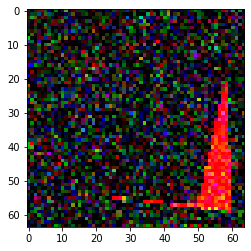

In [ ]:
images = []
images_test = []
images_noising = []
n_images = 10000
for i in range(n_images):
  image = Image.new("RGB", (64, 64))
  draw = ImageDraw.Draw(image)
  ini = (np.random.randint(65), np.random.randint(65))
  points = (ini, (np.random.randint(65), np.random.randint(65)), (np.random.randint(65), np.random.randint(65)), (np.random.randint(65), np.random.randint(65)), ini)
  draw.polygon((points), fill=200)
  images.append(np.asarray(image))
  
  gauss =  0.3*np.random.normal(loc=0.0, scale=1.0, size=images[i].shape)
  gauss = gauss.reshape(images[i].shape)
  image_noising = images[i] + gauss
  image_noising = np.clip(image_noising, 0., 255.)
  images_noising.append(np.asarray(image_noising))

for i in range(n_images):
  image = Image.new("RGB", (64, 64))
  draw = ImageDraw.Draw(image)
  ini = (np.random.randint(65), np.random.randint(65))
  points = (ini, (np.random.randint(65), np.random.randint(65)), (np.random.randint(65), np.random.randint(65)), (np.random.randint(65), np.random.randint(65)), ini)
  draw.polygon((points), fill=200)
  images_test.append(np.asarray(image))

images_noising = np.array(images_noising)
images = np.array(images)
images_test = np.array(images_test)

# plt.imshow(images[9])
plt.imshow(images_noising[9])

split_train = int(n_images*0.8)
x_train = images[:split_train].astype('float32') / 255.
x_test = images_test.astype('float32') / 255.

x_train_noising = images_noising[:split_train].astype('float32') / 255.
x_test_noising = images_noising[split_train:].astype('float32') / 255.

In [ ]:
%tensorflow_version 1.x
from keras.models import Model
from keras.layers import Input, Dense, Conv2D, MaxPooling2D, UpSampling2D, Flatten, Layer, Reshape, Conv2DTranspose
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import LearningRateScheduler

In [ ]:
# ENCODER
input_img = Input(shape=(64, 64, 3))  
x = Conv2D(48, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(96, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(192, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
encoded = Conv2D(32, (1, 1), activation='relu', padding='same')(x)

# LATENT SPACE
latentSize = (8,8,32)

# DECODER
direct_input = Input(shape=latentSize)
x = Conv2D(192, (1, 1), activation='relu', padding='same')(direct_input)
x = UpSampling2D((2, 2))(x)
x = Conv2D(192, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(96, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(48, (3, 3), activation='relu', padding='same')(x)
decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

# COMPILE
encoder = Model(input_img, encoded)
decoder = Model(direct_input, decoded)
autoencoder = Model(input_img, decoder(encoded))

autoencoder.compile(optimizer='Adam', loss='binary_crossentropy')
autoencoder.summary()

Model: "model_48"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_31 (InputLayer)        (None, 64, 64, 3)         0         
_________________________________________________________________
conv2d_136 (Conv2D)          (None, 64, 64, 48)        1344      
_________________________________________________________________
max_pooling2d_46 (MaxPooling (None, 32, 32, 48)        0         
_________________________________________________________________
conv2d_137 (Conv2D)          (None, 32, 32, 96)        41568     
_________________________________________________________________
max_pooling2d_47 (MaxPooling (None, 16, 16, 96)        0         
_________________________________________________________________
conv2d_138 (Conv2D)          (None, 16, 16, 192)       166080    
_________________________________________________________________
max_pooling2d_48 (MaxPooling (None, 8, 8, 192)         0  



#1.   Entrenamiento DAE (30% noise)




In [ ]:
history = autoencoder.fit(x_train_noising, x_train,
                epochs=50,
                batch_size=128,
                shuffle=True,
                validation_split= 0.2, verbose=1)

Train on 6400 samples, validate on 1600 samples
Epoch 1/50
6400/6400 [==============================] - 5s 833us/step - loss: 0.1450 - val_loss: 0.0406
Epoch 2/50
6400/6400 [==============================] - 4s 622us/step - loss: 0.0321 - val_loss: 0.0304
Epoch 3/50
6400/6400 [==============================] - 4s 623us/step - loss: 0.0274 - val_loss: 0.0276
Epoch 4/50
6400/6400 [==============================] - 4s 623us/step - loss: 0.0259 - val_loss: 0.0265
Epoch 5/50
6400/6400 [==============================] - 4s 626us/step - loss: 0.0249 - val_loss: 0.0257
Epoch 6/50
6400/6400 [==============================] - 4s 622us/step - loss: 0.0243 - val_loss: 0.0252
Epoch 7/50
6400/6400 [==============================] - 4s 625us/step - loss: 0.0239 - val_loss: 0.0247
Epoch 8/50
6400/6400 [==============================] - 4s 625us/step - loss: 0.0234 - val_loss: 0.0243
Epoch 9/50
6400/6400 [==============================] - 4s 629us/step - loss: 0.0231 - val_loss: 0.0242
Epoch 10/50
6400

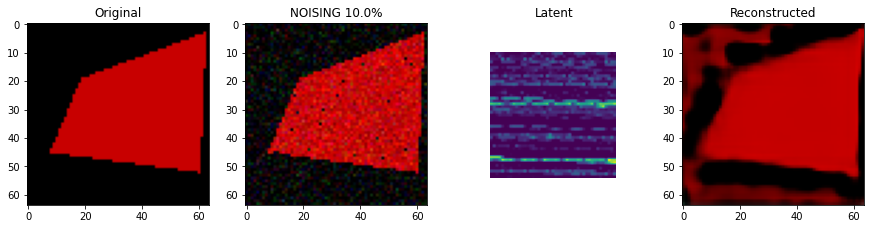

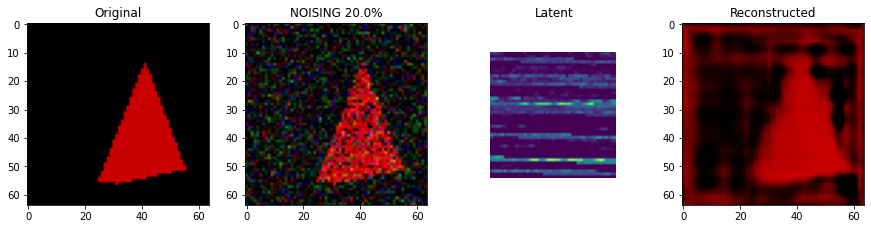

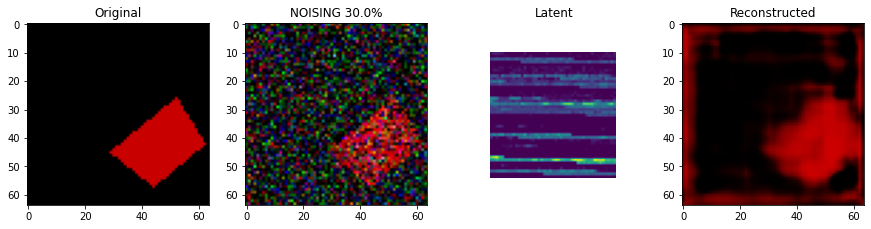

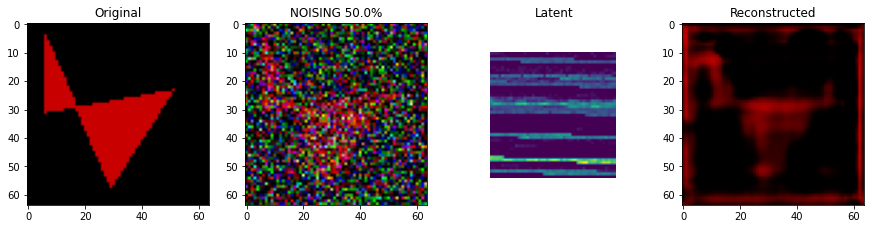

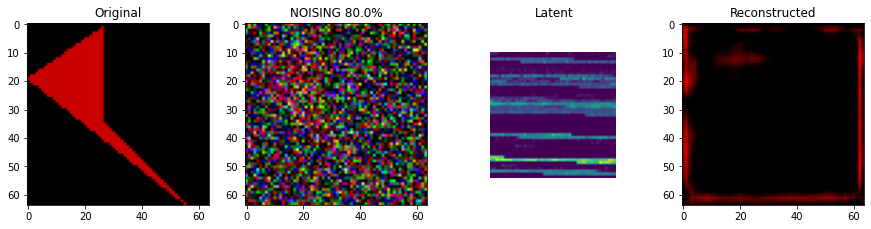

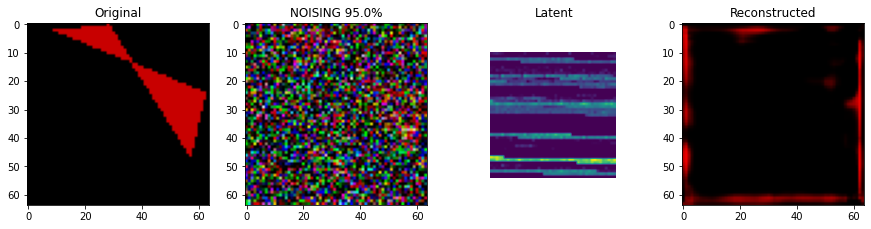

In [ ]:
diff = []
images = x_test
for i in range(6):

    plt.figure(figsize=(15,5))
    plt.subplot(1,4,1)
    
    # ORIGINAL IMAGE
    orig = images[i,:,:,:].reshape((-1,64,64,3))
    img_or = Image.fromarray((255*orig).astype('uint8').reshape((64,64,3)))
    plt.title('Original')
    plt.imshow(img_or)

    # NOISING IMAGE
    orig_noising = images[i,:,:,:].reshape((-1,64,64,3))
    noise = [0.1, 0.2, 0.3, 0.5, 0.8, 0.95]
    gauss =  noise[i]*np.random.normal(loc=0.0, scale=1.0, size=orig_noising.shape)
    gauss = gauss.reshape(orig_noising.shape)
    orig_noising = orig_noising + gauss
    orig_noising = np.clip(orig_noising, 0., 255.)
    
    img = Image.fromarray( (255*orig_noising).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,2)
    plt.title(f'NOISING {noise[i]*100}%')
    plt.imshow(img)
    
    # LATENT IMAGE
    latent_img = encoder.predict(orig_noising)
    mx = np.max( latent_img[0] )
    mn = np.min( latent_img[0] )
    latent_flat = ((latent_img[0] - mn) * 255/(mx - mn)).flatten(order='F')
    img = Image.fromarray( latent_flat[:2025].astype('uint8').reshape((45,45)), mode='L') 
    plt.subplot(1,4,3)
    plt.title('Latent')
    plt.xlim((-10,55))
    plt.ylim((-10,55))
    plt.axis('off')
    plt.imshow(img)

    # RECONSTRUCTED IMAGE
    decoded_imgs = decoder.predict(latent_img[0].reshape((-1,latentSize[0],latentSize[1],latentSize[2])))
    img_re = Image.fromarray( (255*decoded_imgs[0]).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,4)
    plt.title('Reconstructed')
    plt.imshow(img_re)
    plt.show()

    original_images = np.asarray(img_or)
    reconstructed_images = np.asarray(img_re)
    diff.append(np.sum((original_images-reconstructed_images)**2)/(original_images.shape[0]*original_images.shape[1]))

Se puede apreciar que al ir agregando ruido a una imagen random del dataset de entrenamiento, la figura principal tiende a desaparecer, quedando solo los bordes del cuadrado

In [ ]:
from keras.layers import Input, Conv2D, Flatten, Dense, Conv2DTranspose, Reshape, Lambda, Activation, BatchNormalization, LeakyReLU, Dropout
from keras import backend as K
from keras.optimizers import Adam

In [ ]:
# ENCODER
input_img_vae = Input(shape=(64, 64, 3))  
x_v = Conv2D(48, (3, 3), activation='relu', padding='same')(input_img_vae)
x_v = MaxPooling2D((2, 2), padding='same')(x_v)
x_v = Conv2D(96, (3, 3), activation='relu', padding='same')(x_v)
x_v = MaxPooling2D((2, 2), padding='same')(x_v)
x_v = Conv2D(192, (3, 3), activation='relu', padding='same')(x_v)
x_v = MaxPooling2D((2, 2), padding='same')(x_v)
encoded_vae = Conv2D(32, (1, 1), activation='relu', padding='same')(x_v)

output_dim = 2048
mean_mu = Dense(output_dim, name = 'mu')(x_v)
log_var = Dense(output_dim, name = 'log_var')(x_v)

# Defining a function for sampling
def sampling(args):
  mean_mu, log_var = args
  epsilon = K.random_normal(shape=K.shape(mean_mu), mean=0., stddev=1.) 
  return mean_mu + K.exp(log_var/2)*epsilon   
  
# Using a Keras Lambda Layer to include the sampling function as a layer 
# in the model
encoder_output = Lambda(sampling, name='encoder_output')([mean_mu, log_var])

# LATENT SPACE
# latentSize = (8,8,32)

# DECODER
direct_input_vae = Input(shape=latentSize)
x_v = Conv2D(192, (1, 1), activation='relu', padding='same')(direct_input_vae)
x_v = UpSampling2D((2, 2))(x_v)
x_v = Conv2D(192, (3, 3), activation='relu', padding='same')(x_v)
x_v = UpSampling2D((2, 2))(x_v)
x_v = Conv2D(96, (3, 3), activation='relu', padding='same')(x_v)
x_v = UpSampling2D((2, 2))(x_v)
x_v = Conv2D(48, (3, 3), activation='relu', padding='same')(x_v)
decoded_vae = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x_v)

# COMPILE
encoder_vae = Model(input_img_vae, encoded_vae)
decoder_vae = Model(direct_input_vae, decoded_vae)
autoencoder_vae = Model(input_img_vae, decoder_vae(encoded_vae))

LEARNING_RATE = 0.0005
# N_EPOCHS = 20
LOSS_FACTOR = 10000
 
def kl_loss(y_true, y_pred):
    kl_loss =  -0.5 * K.sum(1 + log_var - K.square(mean_mu) - K.exp(log_var), axis = 1)
    return kl_loss
 
def total_loss(y_true, y_pred):
    return LOSS_FACTOR*r_loss(y_true, y_pred) + kl_loss(y_true, y_pred)
   
def r_loss(y_true, y_pred):
    return K.mean(K.square(y_true - y_pred), axis = [1,2,3])
    
adam_optimizer = Adam(lr = LEARNING_RATE)

autoencoder_vae.compile(optimizer=adam_optimizer, loss = 'binary_crossentropy', metrics = [r_loss, kl_loss])



#2.   Entrenamiento **VAE**

In [ ]:
history = autoencoder_vae.fit(x_train, x_train,
                epochs=50,
                batch_size=128,
                shuffle=True,
                validation_split=0.2, verbose=1)

Train on 6400 samples, validate on 1600 samples
Epoch 1/50
6400/6400 [==============================] - 5s 826us/step - loss: 0.1789 - r_loss: 0.0489 - kl_loss: 0.0082 - val_loss: 0.0358 - val_r_loss: 0.0047 - val_kl_loss: 0.0103
Epoch 2/50
6400/6400 [==============================] - 4s 677us/step - loss: 0.0304 - r_loss: 0.0033 - kl_loss: 0.0118 - val_loss: 0.0298 - val_r_loss: 0.0028 - val_kl_loss: 0.0122
Epoch 3/50
6400/6400 [==============================] - 4s 679us/step - loss: 0.0276 - r_loss: 0.0025 - kl_loss: 0.0125 - val_loss: 0.0280 - val_r_loss: 0.0022 - val_kl_loss: 0.0134
Epoch 4/50
6400/6400 [==============================] - 4s 676us/step - loss: 0.0264 - r_loss: 0.0021 - kl_loss: 0.0139 - val_loss: 0.0274 - val_r_loss: 0.0020 - val_kl_loss: 0.0148
Epoch 5/50
6400/6400 [==============================] - 4s 674us/step - loss: 0.0256 - r_loss: 0.0018 - kl_loss: 0.0153 - val_loss: 0.0263 - val_r_loss: 0.0017 - val_kl_loss: 0.0160
Epoch 6/50
6400/6400 [====================

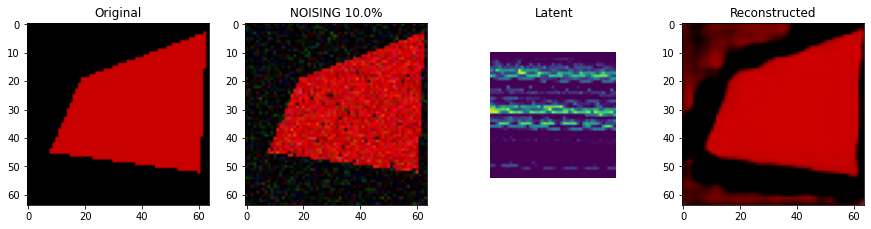

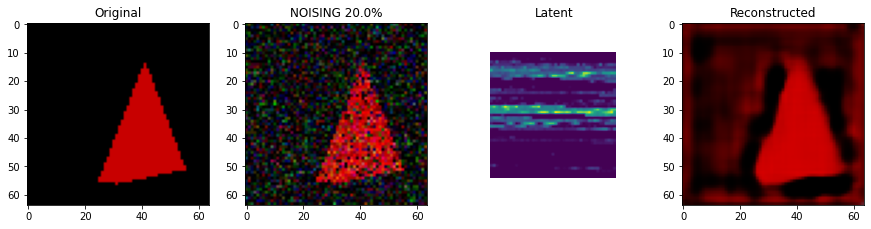

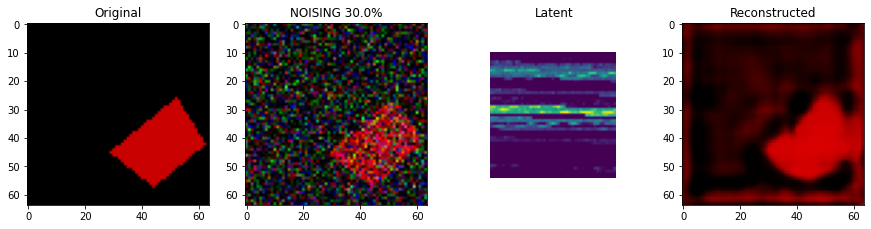

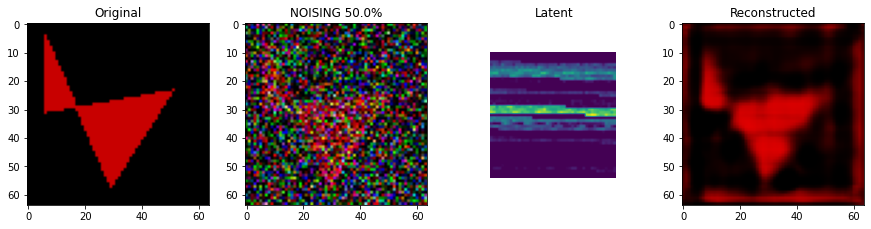

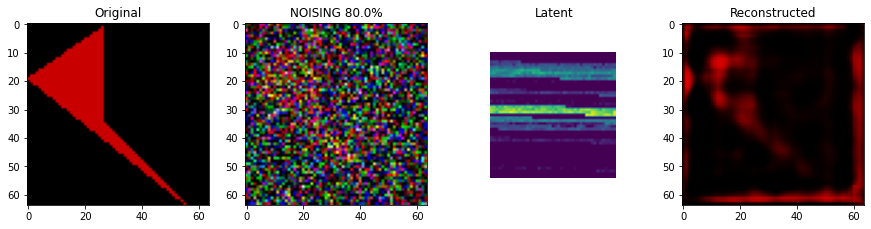

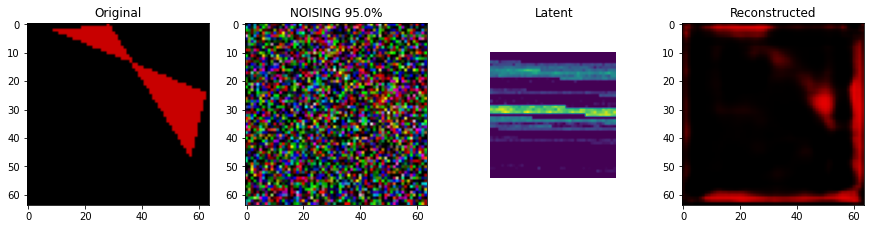

In [ ]:
diff_vae = []
for i in range(6):

    plt.figure(figsize=(15,5))
    plt.subplot(1,4,1)
    
    # ORIGINAL IMAGE
    orig = images[i,:,:,:].reshape((-1,64,64,3))
    img_or_vae = Image.fromarray( (255*orig).astype('uint8').reshape((64,64,3)))
    plt.title('Original')
    plt.imshow(img_or_vae)

    # NOISING IMAGE
    orig_noising = images[i,:,:,:].reshape((-1,64,64,3))
    noise = [0.1, 0.2, 0.3, 0.5, 0.8, 0.95]
    gauss =  noise[i]*np.random.normal(loc=0.0, scale=1.0, size=orig_noising.shape)
    gauss = gauss.reshape(orig_noising.shape)
    orig_noising = orig_noising + gauss
    orig_noising = np.clip(orig_noising, 0., 255.)
    
    img = Image.fromarray( (255*orig_noising).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,2)
    plt.title(f'NOISING {noise[i]*100}%')
    plt.imshow(img)
    
    # LATENT IMAGE
    latent_img = encoder_vae.predict(orig_noising)
    mx = np.max( latent_img[0] )
    mn = np.min( latent_img[0] )
    latent_flat = ((latent_img[0] - mn) * 255/(mx - mn)).flatten(order='F')
    img = Image.fromarray( latent_flat[:2025].astype('uint8').reshape((45,45)), mode='L') 
    plt.subplot(1,4,3)
    plt.title('Latent')
    plt.xlim((-10,55))
    plt.ylim((-10,55))
    plt.axis('off')
    plt.imshow(img)

    # RECONSTRUCTED IMAGE
    decoded_imgs = decoder_vae.predict(latent_img[0].reshape((-1,latentSize[0],latentSize[1],latentSize[2])))
    img_re_vae = Image.fromarray( (255*decoded_imgs[0]).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,4)
    plt.title('Reconstructed')
    plt.imshow(img_re_vae)
    plt.show()

    original_images_vae = np.asarray(img_or_vae)
    reconstructed_images_vae = np.asarray(img_re_vae)
    diff_vae.append(np.sum((original_images_vae-reconstructed_images_vae)**2)/(original_images_vae.shape[0]*original_images_vae.shape[1]))

En este caso y a diferencia del denoisig autoencoder, **VAE**, a pesar del ruido extra intenta representar una figura, manteniendose el patron de dibujar bordes, además se puede apreciar que agrefa ruido a la imagen reconstruida.

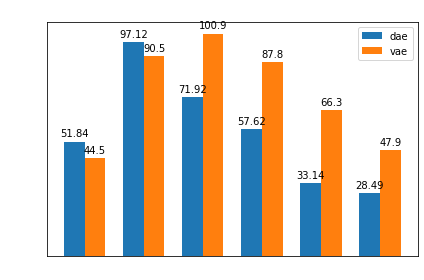

In [ ]:
labels = ['10%', '20%', '30%', '50%', '80%', '95%']
diff = np.around(diff, 2)
diff_vae = np.around(diff_vae, 1)

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, diff, width, label='dae')
rects2 = ax.bar(x + width/2, diff_vae, width, label='vae')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('MSE', color="w")
ax.set_title('DAE vs VAE MSE (adding noise)', color="w")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.tick_params(axis='x', colors='w') #white x axis
ax.tick_params(axis='y', colors='w') #white y axis
ax.legend()

def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

fig.tight_layout()
plt.show()

Para las 6 imagenes random de test que se eligieron para probar los dos métodos, se puede apreciar que se da que dae tiene un mejor rendimiento, esto se puede deber a que dado que los póligonos son generados por un random, vae no logra modelar una distribucion exacta, también se puede deber a que las imagenes tomadas al azar favorecen a dae.

In [ ]:
ruidos = [0.1,0.2,0.3,0.5,0.8]
mse_dae = []
mse_vae = []

for i in ruidos:
  x_data_noise_sample = x_test + i * np.random.normal(loc=0.0, scale=1.0, size=x_test.shape) 
  predictions_dae  = autoencoder.predict(x_data_noise_sample[:100])
  predictions_vae  = autoencoder_vae.predict(x_data_noise_sample[:100])
  suma_img_dae = 0
  suma_img_vae = 0
  for j in range(100):
    suma_img_dae = suma_img_dae + np.sum((x_test[j]-predictions_dae[j])**2) / (x_test[j].shape[0]*x_test[j].shape[1])
    suma_img_vae = suma_img_vae + np.sum((x_test[j]-predictions_vae[j])**2) / (x_test[j].shape[0]*x_test[j].shape[1])
  mse_dae.append(suma_img_dae/100)
  mse_vae.append(suma_img_vae/100)

print(mse_dae)
print(mse_vae)

[0.02665462151169777, 0.030427234191447498, 0.0496856657601893, 0.09182356283068657, 0.09700398502871393]
[0.016370761347934602, 0.018671026965603233, 0.02958757014013827, 0.05767461745068431, 0.07767012828961015]


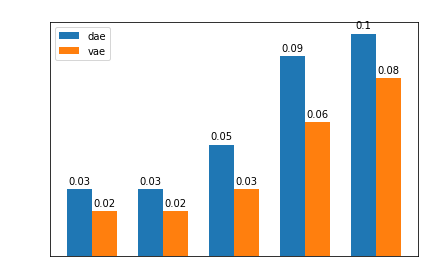

In [ ]:
labels = ['10%', '20%', '30%', '50%', '80%']
mse_dae = np.around(mse_dae, 2)
mse_vae = np.around(mse_vae, 2)

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, mse_dae, width, label='dae')
rects2 = ax.bar(x + width/2, mse_vae, width, label='vae')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('MSE', color="w")
ax.set_title('DAE vs VAE MSE (adding noise)', color="w")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.tick_params(axis='x', colors='w') #white x axis
ax.tick_params(axis='y', colors='w') #white y axis
ax.legend()

def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

fig.tight_layout()
plt.show()

Al tomar todo el dataset de entrenamiento, agregarles ruido y sacar el **MSE** se puede apreciar que DAE tiene una menor robustez de representación que vae ante distintos casos de poligonos generados.

## Dataset Real (perros)


In [ ]:
!wget --header="Host: storage.googleapis.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/83.0.4103.116 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: es-CL,es;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: https://www.kaggle.com/" "https://storage.googleapis.com/kagglesdsdata/competitions/15062/545987/all-dogs.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1594426456&Signature=H4NuuQMXqb8sCi23ULzjyapHz4poy19IPD5p5BZQNrC9dsbQP8u222AvWOLga%2F8WlDMrr4g15QEgR66RYUoBH9iIWk49LI%2BMCrkbugv2Mxbl7E23nq%2BhmrJ6NhCv9Ij61%2Frqm1BMrY7SM8pmPCqrTce4OF2M%2FljtmBRS8Z4xkJf2j8wSCELn9Fk%2F7exUpjPNRYZ6WmsnhQrkinfLHyKmySjgwOknoyVQzfd%2FQnHj1YsdKsLbADGnSQmGS3%2FCpAQRNc7RrCdBMe6Vccqo0WDY4M1g6UAWUGKfjUPN4npbg%2BGDxbeo0SVtWBnl%2F8aJR4N%2BZSGSxMcYK2CuhUadmIKn8Q%3D%3D&response-content-disposition=attachment%3B+filename%3Dall-dogs.zip" -c -O 'all-dogs.zip'
!unzip \*.zip  && rm *.zip

Se truncaron las últimas líneas 5000 del resultado de transmisión.
  inflating: all-dogs/n02107683_215.jpg  
  inflating: all-dogs/n02093428_5326.jpg  
  inflating: all-dogs/n02105412_8018.jpg  
  inflating: all-dogs/n02093647_3129.jpg  
  inflating: all-dogs/n02088466_8078.jpg  
  inflating: all-dogs/n02108915_4214.jpg  
  inflating: all-dogs/n02089078_2841.jpg  
  inflating: all-dogs/n02105855_3498.jpg  
  inflating: all-dogs/n02094114_2823.jpg  
  inflating: all-dogs/n02088094_649.jpg  
  inflating: all-dogs/n02091831_2232.jpg  
  inflating: all-dogs/n02096585_3105.jpg  
  inflating: all-dogs/n02109961_977.jpg  
  inflating: all-dogs/n02097047_5869.jpg  
  inflating: all-dogs/n02106030_16250.jpg  
  inflating: all-dogs/n02110958_13721.jpg  
  inflating: all-dogs/n02107142_8437.jpg  
  inflating: all-dogs/n02094433_1312.jpg  
  inflating: all-dogs/n02097474_5481.jpg  
  inflating: all-dogs/n02097130_1531.jpg  
  inflating: all-dogs/n02092339_284.jpg  
  inflating: all-dogs/n02093859_

In [ ]:
%tensorflow_version 1.x
from keras.models import Model
from keras.layers import Input, Dense, Conv2D, MaxPooling2D, UpSampling2D, Flatten, Layer, Reshape, Conv2DTranspose
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import LearningRateScheduler

TensorFlow 1.x selected.


Using TensorFlow backend.


In [ ]:
import os, gc, zipfile
import numpy as np, pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

PATH = '/content/all-dogs/'
IMAGES = os.listdir(PATH)
print('There are',len(IMAGES),'images. Here are 5 example filesnames:')
print(IMAGES[:5])

There are 20579 images. Here are 5 example filesnames:
['n02108000_3635.jpg', 'n02091244_2919.jpg', 'n02096585_1753.jpg', 'n02093647_2108.jpg', 'n02110958_8583.jpg']


In [ ]:
os.mkdir('./tmp')
os.mkdir('./tmp/images')
os.mkdir('./test')
os.mkdir('./test/images_test')

FileExistsError: ignored

In [ ]:
# CREATE RANDOMLY CROPPED IMAGES
for i in range(10000):
    img = Image.open(PATH + IMAGES[i%len(IMAGES)])
    img = img.resize(( 100,int(img.size[1]/(img.size[0]/100) )), Image.ANTIALIAS)
    w = img.size[0]; h = img.size[1]; a=0; b=0
    if w>64: a = np.random.randint(0,w-64)
    if h>64: b = np.random.randint(0,h-64)
    img = img.crop((a, b, 64+a, 64+b))
    img.save('./tmp/images/'+str(i)+'.png','PNG')
    if i%100000==0: print('created',i,'cropped images')
print(f'created {i} cropped images')

created 0 cropped images
created 99999 cropped images


In [ ]:
# CREATE RANDOMLY CROPPED IMAGES
for i in range(2000):
    img = Image.open(PATH + IMAGES[i%len(IMAGES)])
    img = img.resize(( 100,int(img.size[1]/(img.size[0]/100) )), Image.ANTIALIAS)
    w = img.size[0]; h = img.size[1]; a=0; b=0
    if w>64: a = np.random.randint(0,w-64)
    if h>64: b = np.random.randint(0,h-64)
    img = img.crop((a, b, 64+a, 64+b))
    img.save('./test/images_test/'+str(i)+'.png','PNG')
    if i%100000==0: print('created',i,'cropped images')
print(f'created {i} cropped images')

created 0 cropped images
created 19999 cropped images


In [ ]:
from tqdm import tqdm

In [ ]:
data = []
c = 0
for png in tqdm(os.listdir('./tmp/images')):
    path = './tmp/images/{}'.format(png)
    
    image = plt.imread(path)
    image = image.astype('float32')
    data.append(image)
    c +=1
    if c > 10000:
      break
data = np.array(data)




  0%|          | 0/100000 [00:00<?, ?it/s]


  0%|          | 231/100000 [00:00<00:43, 2302.08it/s]


  0%|          | 453/100000 [00:00<00:43, 2275.90it/s]


  1%|          | 669/100000 [00:00<00:44, 2236.74it/s]


  1%|          | 892/100000 [00:00<00:44, 2233.05it/s]


  1%|          | 1109/100000 [00:00<00:44, 2211.81it/s]


  1%|▏         | 1334/100000 [00:00<00:44, 2223.00it/s]


  2%|▏         | 1558/100000 [00:00<00:44, 2225.62it/s]


  2%|▏         | 1779/100000 [00:00<00:44, 2218.18it/s]


  2%|▏         | 1998/100000 [00:00<00:44, 2208.19it/s]


  2%|▏         | 2210/100000 [00:01<00:46, 2103.63it/s]


  2%|▏         | 2435/100000 [00:01<00:45, 2143.67it/s]


  3%|▎         | 2661/100000 [00:01<00:44, 2176.61it/s]


  3%|▎         | 2877/100000 [00:01<00:44, 2161.90it/s]


  3%|▎         | 3100/100000 [00:01<00:44, 2181.65it/s]


  3%|▎         | 3318/100000 [00:01<00:44, 2152.04it/s]


  4%|▎         | 3539/100000 [00:01<00:44, 2166.39it/s]


  4%|▍         | 3762/100000

In [ ]:
data_test = []
c=0
for png in tqdm(os.listdir('./test/images_test')):
    path = './test/images_test/{}'.format(png)
    
    image = plt.imread(path)
    image = image.astype('float32')
    data_test.append(image)
    c+=1
    if c > 2000:
      break
    
data_test = np.array(data_test)



  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 9/20000 [00:00<05:28, 60.84it/s]

  0%|          | 21/20000 [00:00<04:41, 71.04it/s]

  0%|          | 28/20000 [00:00<04:42, 70.65it/s]

  0%|          | 44/20000 [00:00<03:55, 84.65it/s]

  0%|          | 74/20000 [00:00<03:04, 107.87it/s]

  1%|          | 123/20000 [00:00<02:21, 140.73it/s]

  1%|          | 177/20000 [00:00<01:49, 180.66it/s]

  1%|          | 231/20000 [00:00<01:27, 225.15it/s]

  1%|▏         | 280/20000 [00:00<01:13, 268.10it/s]

  2%|▏         | 329/20000 [00:01<01:03, 309.88it/s]

  2%|▏         | 378/20000 [00:01<00:56, 347.59it/s]

  2%|▏         | 431/20000 [00:01<00:50, 386.45it/s]

  2%|▏         | 485/20000 [00:01<00:46, 421.12it/s]

  3%|▎         | 537/20000 [00:01<00:43, 445.55it/s]

  3%|▎         | 591/20000 [00:01<00:41, 469.70it/s]

  3%|▎         | 643/20000 [00:01<00:40, 481.96it/s]

  3%|▎         | 697/20000 [00:01<00:38, 496.80it/s]

  4%|▍         | 751/20000 [00:01<00:37, 508.71

In [ ]:
import random
def add_noise(imgs, noise_factor=0.5):
    '''Add random noise to an image'''
    noise = imgs + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=imgs.shape)
    noise = np.clip(noise, 0., 255.)
    return noise

BATCH_SIZE = 256; EPOCHS = 50

train_batches_vae = data
train_batches = add_noise(data)
test_datagen = data_test
test_batches_vae = train_batches_vae[:]

In [ ]:
# ENCODER
input_img = Input(shape=(64, 64, 3))  
x = Conv2D(48, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(96, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(192, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
encoded = Conv2D(32, (1, 1), activation='relu', padding='same')(x)

# LATENT SPACE
latentSize = (8,8,32)

# DECODER
direct_input = Input(shape=latentSize)
x = Conv2D(192, (1, 1), activation='relu', padding='same')(direct_input)
x = UpSampling2D((2, 2))(x)
x = Conv2D(192, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(96, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(48, (3, 3), activation='relu', padding='same')(x)
decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

# COMPILE
encoder = Model(input_img, encoded)
decoder = Model(direct_input, decoded)
autoencoder = Model(input_img, decoder(encoded))

autoencoder.compile(optimizer='Adam', loss='binary_crossentropy')
autoencoder.summary()

Model: "model_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_13 (InputLayer)        (None, 64, 64, 3)         0         
_________________________________________________________________
conv2d_55 (Conv2D)           (None, 64, 64, 48)        1344      
_________________________________________________________________
max_pooling2d_19 (MaxPooling (None, 32, 32, 48)        0         
_________________________________________________________________
conv2d_56 (Conv2D)           (None, 32, 32, 96)        41568     
_________________________________________________________________
max_pooling2d_20 (MaxPooling (None, 16, 16, 96)        0         
_________________________________________________________________
conv2d_57 (Conv2D)           (None, 16, 16, 192)       166080    
_________________________________________________________________
max_pooling2d_21 (MaxPooling (None, 8, 8, 192)         0  

# 1. Entrenamiento DAE (50% noise)

In [ ]:
history = autoencoder.fit(train_batches,train_batches_vae,
                epochs=20,
                batch_size=BATCH_SIZE,
                shuffle=True,
                validation_split=0.2, verbose=1)

Train on 8000 samples, validate on 2001 samples
Epoch 1/20
8000/8000 [==============================] - 5s 641us/step - loss: 0.5659 - val_loss: 0.5642
Epoch 2/20
8000/8000 [==============================] - 5s 638us/step - loss: 0.5652 - val_loss: 0.5640
Epoch 3/20
8000/8000 [==============================] - 5s 636us/step - loss: 0.5646 - val_loss: 0.5630
Epoch 4/20
8000/8000 [==============================] - 5s 639us/step - loss: 0.5655 - val_loss: 0.5631
Epoch 5/20
8000/8000 [==============================] - 5s 643us/step - loss: 0.5638 - val_loss: 0.5624
Epoch 6/20
8000/8000 [==============================] - 5s 642us/step - loss: 0.5635 - val_loss: 0.5627
Epoch 7/20
8000/8000 [==============================] - 5s 641us/step - loss: 0.5639 - val_loss: 0.5621
Epoch 8/20
8000/8000 [==============================] - 5s 638us/step - loss: 0.5629 - val_loss: 0.5618
Epoch 9/20
8000/8000 [==============================] - 5s 637us/step - loss: 0.5625 - val_loss: 0.5614
Epoch 10/20
8000

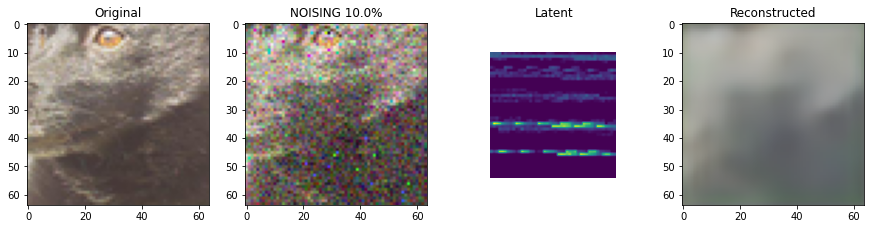

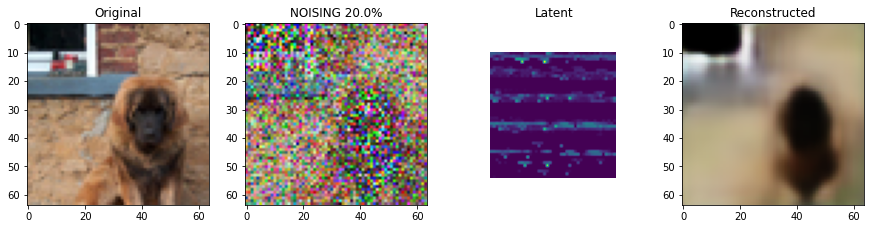

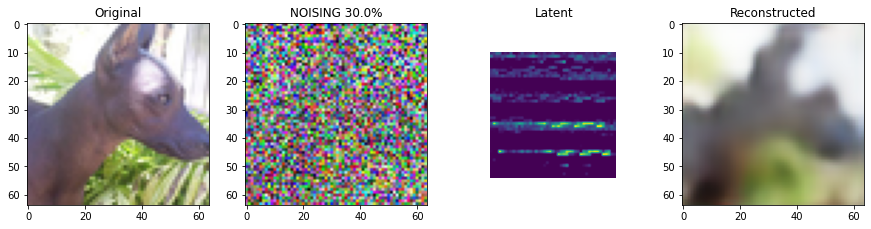

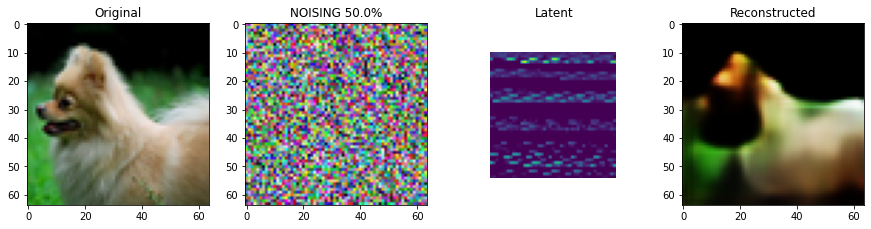

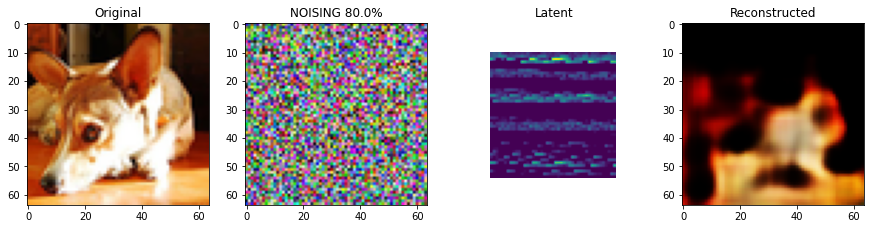

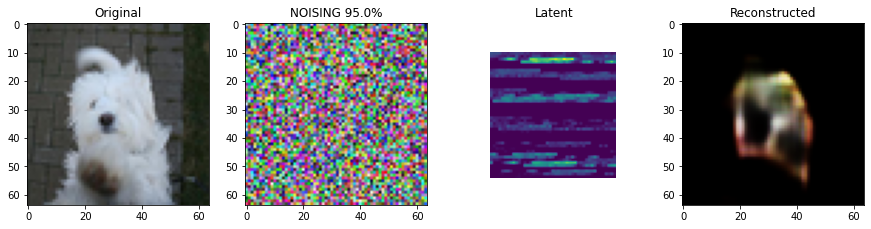

In [ ]:
diff = []
images = test_datagen
for i in range(6):

    plt.figure(figsize=(15,5))
    plt.subplot(1,4,1)
    
    # ORIGINAL IMAGE
    orig = images[i,:,:,:].reshape((-1,64,64,3))
    img_or = Image.fromarray( (255*orig).astype('uint8').reshape((64,64,3)))
    plt.title('Original')
    plt.imshow(img_or)

    # NOISING IMAGE
    orig_noising = images[i,:,:,:].reshape((-1,64,64,3))
    noise = [0.1, 0.2, 0.3, 0.5, 0.8, 0.95]
    gauss =  noise[i]*np.random.normal(loc=0.0, scale=1.0, size=orig_noising.shape)
    gauss = gauss.reshape(orig_noising.shape)
    orig_noising = orig_noising + gauss
    # orig_noising = np.clip(orig_noising, 0., 255.)
    
    img = Image.fromarray( (255*orig_noising).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,2)
    plt.title(f'NOISING {noise[i]*100}%')
    plt.imshow(img)
    
    # LATENT IMAGE
    latent_img = encoder.predict(orig_noising)
    mx = np.max( latent_img[0] )
    mn = np.min( latent_img[0] )
    latent_flat = ((latent_img[0] - mn) * 255/(mx - mn)).flatten(order='F')
    img = Image.fromarray( latent_flat[:2025].astype('uint8').reshape((45,45)), mode='L') 
    plt.subplot(1,4,3)
    plt.title('Latent')
    plt.xlim((-10,55))
    plt.ylim((-10,55))
    plt.axis('off')
    plt.imshow(img)

    # RECONSTRUCTED IMAGE
    decoded_imgs = autoencoder.predict(orig_noising)
    img_re = Image.fromarray( (255*decoded_imgs[0]).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,4)
    plt.title('Reconstructed')
    plt.imshow(img_re)
    plt.show()

    original_images = np.asarray(img_or)
    reconstructed_images = np.asarray(img_re)
    diff.append(np.sum((original_images-reconstructed_images)**2)/(original_images.shape[0]*original_images.shape[1]))

En general podemos notar que el rendimiento de reconstruir los perritos es bastante baja, esto se debe a la cantidad de datos utilizados (8000 imágenes) y la variedad de razas de perros en las fotos, considerando  esto podemos notar que los ruidos intermedios son las imagenes que mejor se distingue la relación con la imagen original.

In [ ]:
from keras.layers import Input, Conv2D, Flatten, Dense, Conv2DTranspose, Reshape, Lambda, Activation, BatchNormalization, LeakyReLU, Dropout
from keras import backend as K
from keras.optimizers import Adam

In [ ]:
# ENCODER
input_img_vae = Input(shape=(64, 64, 3))  
x_v = Conv2D(48, (3, 3), activation='relu', padding='same')(input_img_vae)
x_v = MaxPooling2D((2, 2), padding='same')(x_v)
x_v = Conv2D(96, (3, 3), activation='relu', padding='same')(x_v)
x_v = MaxPooling2D((2, 2), padding='same')(x_v)
x_v = Conv2D(192, (3, 3), activation='relu', padding='same')(x_v)
x_v = MaxPooling2D((2, 2), padding='same')(x_v)
encoded_vae = Conv2D(32, (1, 1), activation='relu', padding='same')(x_v)

output_dim = 2048
mean_mu = Dense(output_dim, name = 'mu')(x_v)
log_var = Dense(output_dim, name = 'log_var')(x_v)

# Defining a function for sampling
def sampling(args):
  mean_mu, log_var = args
  epsilon = K.random_normal(shape=K.shape(mean_mu), mean=0., stddev=1.) 
  return mean_mu + K.exp(log_var/2)*epsilon   
  
# Using a Keras Lambda Layer to include the sampling function as a layer 
# in the model
encoder_output = Lambda(sampling, name='encoder_output')([mean_mu, log_var])

# LATENT SPACE
# latentSize = (8,8,32)

# DECODER
direct_input_vae = Input(shape=latentSize)
x_v = Conv2D(192, (1, 1), activation='relu', padding='same')(direct_input_vae)
x_v = UpSampling2D((2, 2))(x_v)
x_v = Conv2D(192, (3, 3), activation='relu', padding='same')(x_v)
x_v = UpSampling2D((2, 2))(x_v)
x_v = Conv2D(96, (3, 3), activation='relu', padding='same')(x_v)
x_v = UpSampling2D((2, 2))(x_v)
x_v = Conv2D(48, (3, 3), activation='relu', padding='same')(x_v)
decoded_vae = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x_v)

# COMPILE
encoder_vae = Model(input_img_vae, encoded_vae)
decoder_vae = Model(direct_input_vae, decoded_vae)
autoencoder_vae = Model(input_img_vae, decoder_vae(encoded_vae))

LEARNING_RATE = 0.0005
# N_EPOCHS = 20
LOSS_FACTOR = 10000
 
def kl_loss(y_true, y_pred):
    kl_loss =  -0.5 * K.sum(1 + log_var - K.square(mean_mu) - K.exp(log_var), axis = 1)
    return kl_loss
 
def total_loss(y_true, y_pred):
    return LOSS_FACTOR*r_loss(y_true, y_pred) + kl_loss(y_true, y_pred)
   
def r_loss(y_true, y_pred):
    return K.mean(K.square(y_true - y_pred), axis = [1,2,3])
    
adam_optimizer = Adam(lr = LEARNING_RATE)

autoencoder_vae.compile(optimizer=adam_optimizer, loss = 'binary_crossentropy', metrics = [r_loss, kl_loss])


#2. Entremamiento VAE

In [ ]:
history_vae = autoencoder_vae.fit(train_batches_vae,train_batches_vae,
              epochs=50,
              batch_size=128,
              shuffle=True,
              validation_split=0.2, verbose=1)

Train on 8000 samples, validate on 2001 samples
Epoch 1/50
8000/8000 [==============================] - 6s 787us/step - loss: 0.5484 - r_loss: 0.0052 - kl_loss: 0.0098 - val_loss: 0.5469 - val_r_loss: 0.0052 - val_kl_loss: 0.0104
Epoch 2/50
8000/8000 [==============================] - 5s 678us/step - loss: 0.5486 - r_loss: 0.0053 - kl_loss: 0.0100 - val_loss: 0.5470 - val_r_loss: 0.0052 - val_kl_loss: 0.0100
Epoch 3/50
8000/8000 [==============================] - 5s 677us/step - loss: 0.5481 - r_loss: 0.0051 - kl_loss: 0.0105 - val_loss: 0.5474 - val_r_loss: 0.0054 - val_kl_loss: 0.0105
Epoch 4/50
8000/8000 [==============================] - 5s 677us/step - loss: 0.5483 - r_loss: 0.0052 - kl_loss: 0.0101 - val_loss: 0.5466 - val_r_loss: 0.0051 - val_kl_loss: 0.0109
Epoch 5/50
8000/8000 [==============================] - 5s 675us/step - loss: 0.5483 - r_loss: 0.0052 - kl_loss: 0.0102 - val_loss: 0.5464 - val_r_loss: 0.0050 - val_kl_loss: 0.0108
Epoch 6/50
8000/8000 [====================

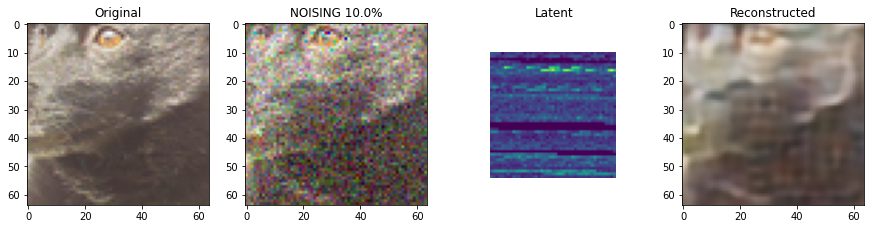

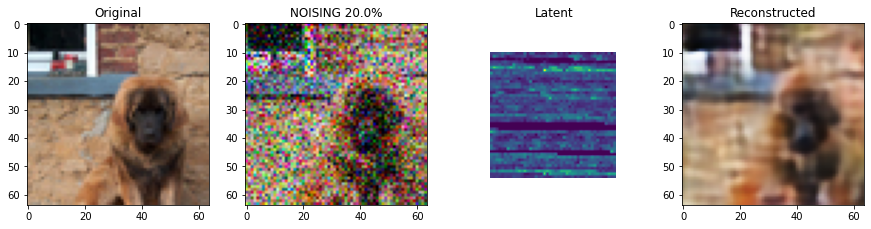

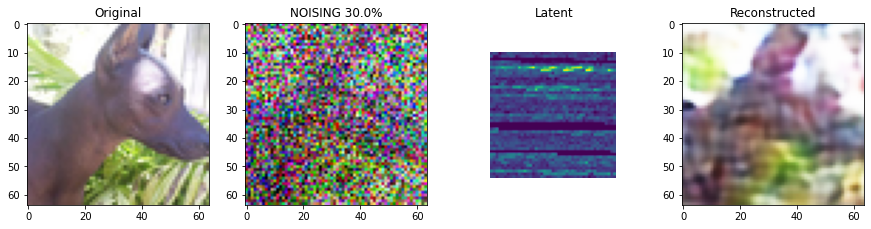

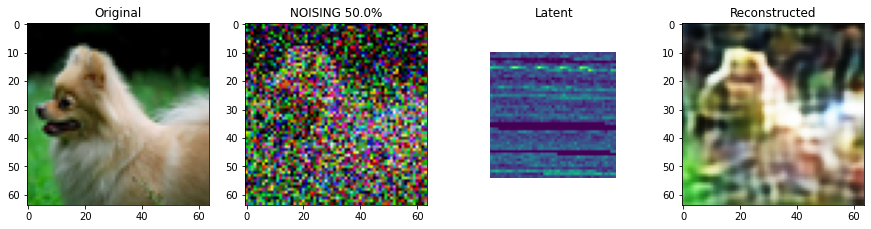

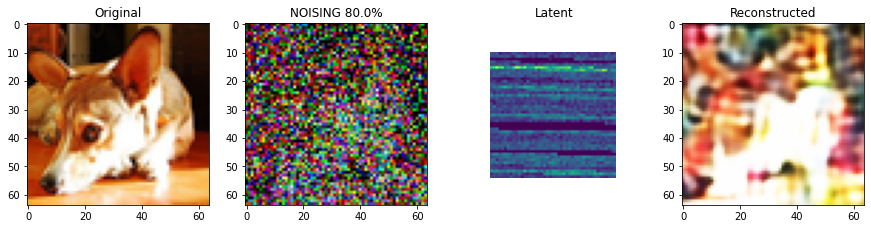

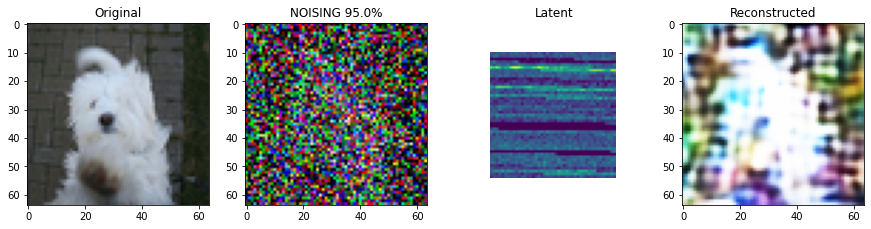

In [ ]:
diff_vae = []
images = test_batches_vae
for i in range(6):

    plt.figure(figsize=(15,5))
    plt.subplot(1,4,1)
    
    # ORIGINAL IMAGE
    orig = images[i,:,:,:].reshape((-1,64,64,3))
    img_or_vae = Image.fromarray( (255*orig).astype('uint8').reshape((64,64,3)))
    plt.title('Original')
    plt.imshow(img_or_vae)

    # NOISING IMAGE
    orig_noising = images[i,:,:,:].reshape((-1,64,64,3))
    noise = [0.1, 0.2, 0.3, 0.5, 0.8, 0.95]
    gauss =  noise[i]*np.random.normal(loc=0.0, scale=1.0, size=orig_noising.shape)
    gauss = gauss.reshape(orig_noising.shape)
    orig_noising = orig_noising + gauss
    orig_noising = np.clip(orig_noising, 0., 255.)
    
    img = Image.fromarray( (255*orig_noising).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,2)
    plt.title(f'NOISING {noise[i]*100}%')
    plt.imshow(img)
    
    # LATENT IMAGE
    latent_img = encoder_vae.predict(orig_noising)
    mx = np.max( latent_img[0] )
    mn = np.min( latent_img[0] )
    latent_flat = ((latent_img[0] - mn) * 255/(mx - mn)).flatten(order='F')
    img = Image.fromarray( latent_flat[:2025].astype('uint8').reshape((45,45)), mode='L') 
    plt.subplot(1,4,3)
    plt.title('Latent')
    plt.xlim((-10,55))
    plt.ylim((-10,55))
    plt.axis('off')
    plt.imshow(img)

    # RECONSTRUCTED IMAGE
    decoded_imgs = decoder_vae.predict(latent_img[0].reshape((-1,latentSize[0],latentSize[1],latentSize[2])))
    img_re_vae = Image.fromarray( (255*decoded_imgs[0]).astype('uint8').reshape((64,64,3)))
    plt.subplot(1,4,4)
    plt.title('Reconstructed')
    plt.imshow(img_re_vae)
    plt.show()

    original_images_vae = np.asarray(img_or_vae)
    reconstructed_images_vae = np.asarray(img_re_vae)
    diff_vae.append(np.sum((original_images_vae-reconstructed_images_vae)**2)/(original_images_vae.shape[0]*original_images_vae.shape[1]))

En el caso de **VAE** los perritos son reconstruido con mayor continuidad de contorno, al agregar ruido se aprecia mayor saturación y menos afinidad de detalles.

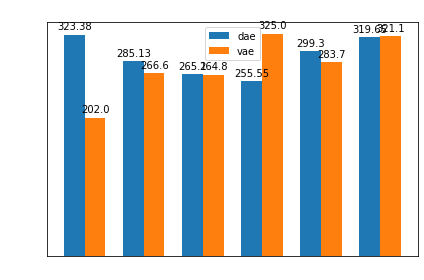

In [ ]:
labels = ['10%', '20%', '30%', '50%', '80%', '95%']
diff = np.around(diff, 2)
diff_vae = np.around(diff_vae, 1)

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, diff, width, label='dae')
rects2 = ax.bar(x + width/2, diff_vae, width, label='vae')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('MSE', color="w")
ax.set_title('DAE vs VAE MSE (adding noise)', color="w")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.tick_params(axis='x', colors='w') #white x axis
ax.tick_params(axis='y', colors='w') #white y axis
ax.legend()

def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

fig.tight_layout()
plt.show()

Dadas estás 6 imágenes al azar se puede apreciar un comportamiento parabolico para el error del dae, esto se debe a que fue entrenado con un ruido del 50% por lo que para imagenes con ruido cercano a ese valor, el desepeño de este será mejor, el vae en cambio tiende a disminuir la capacidad de representación a mayor ruido pero sigue siendo mejor que dae en la mayoria de casos.

[0.04153643328027101, 0.042370565519377124, 0.055716808386932826, 0.15071225474821404, 0.40652246173704043]
[0.014092803286985145, 0.022678913595882477, 0.038237385953834746, 0.09327925827528816, 0.21426259304280393]


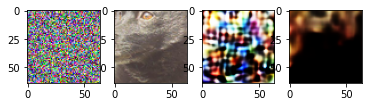

In [ ]:
ruidos = [0.1, 0.2, 0.3, 0.5, 0.8]
mse_dae = []
mse_vae = []

for ruido in ruidos:
  x_data_noise_sample = test_batches_vae + ruido * np.random.normal(loc=0.0, scale=1.0, size=test_batches_vae.shape) 
  predictions_vae  = autoencoder_vae.predict(x_data_noise_sample)
  predictions_dae  = autoencoder.predict(x_data_noise_sample)
  suma_img_dae = 0
  suma_img_vae = 0
  for j in range(256):
    suma_img_vae += np.sum((test_batches_vae[j]-predictions_vae[j])**2) / (test_batches_vae[j].shape[0]*test_batches_vae[j].shape[1])
    suma_img_dae += np.sum((test_batches_vae[j]-predictions_dae[j])**2) / (test_batches_vae[j].shape[0]*test_batches_vae[j].shape[1])
  mse_dae.append(suma_img_dae/256)
  mse_vae.append(suma_img_vae/256)

print(mse_dae)
print(mse_vae)
img = Image.fromarray((255*test_batches_vae[0]).astype('uint8'))
plt.subplot(1,4,2)
plt.imshow(img)
img = Image.fromarray((255*x_data_noise_sample[0]).astype('uint8'))
plt.subplot(1,4,1)
plt.imshow(img)
img_vae = Image.fromarray( (255*predictions_vae[0]).astype('uint8').reshape((64,64,3)))
img_dae = Image.fromarray( (255*predictions_dae[0]).astype('uint8').reshape((64,64,3)))
plt.subplot(1,4,3)
plt.imshow(img_vae)
plt.subplot(1,4,4)
plt.imshow(img_dae)

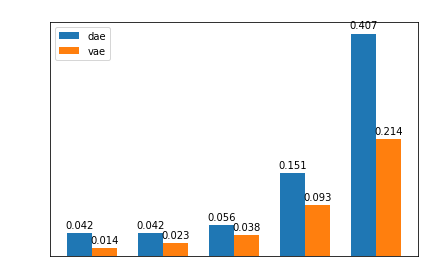

In [ ]:
labels = ['10%', '20%', '30%', '50%', '80%']
mse_dae = np.around(mse_dae, 3)
mse_vae = np.around(mse_vae, 3)

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, mse_dae, width, label='dae')
rects2 = ax.bar(x + width/2, mse_vae, width, label='vae')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('MSE', color="w")
ax.set_title('DAE vs VAE MSE (adding noise)', color="w")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.tick_params(axis='x', colors='w') #white x axis
ax.tick_params(axis='y', colors='w') #white y axis
ax.legend()

def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

fig.tight_layout()
plt.show()

Ahora si tomamos todo el dataset de entrenamiento y revisamos el MSE, se puede concluir que en general **DAE** tiene menor robostez de representación que vae, al agregar más ruido, debido que se esta intentando representar un espacio continuo (fotos) y dae comprime la entrada corrupta a un espacio latente discreto, mientras que al hacer uso de distribuciones permiten el muetreo aleatoria de caracteristicas, permitiendo que no existan brechas abruptas entre las representaciones de estas.

## Dataset Real 2 (Anime)

In [ ]:
import numpy as np
import os

import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm
import cv2

In [ ]:
!wget --header="Host: storage.googleapis.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/83.0.4103.116 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,/;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: es-CL,es;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: https://www.kaggle.com/" "https://storage.googleapis.com/kaggle-data-sets/195056%2F432296%2Fbundle%2Farchive.zip?GoogleAccessId=gcp-kaggle-com@kaggle-161607.iam.gserviceaccount.com&Expires=1594527046&Signature=QJvs401dxMjST9tyWGXizTipgUj5JtEDRI%2FWgbUraSdNuCt212%2B2jDC5F6rqMYwB8%2Fk0bquzU5HJWwPM9RL6J4apR9z7kpZRjawxnqAYjibYrwxlzAjXxCkSIA59s%2ByFoqwg%2FVK5y3hK3CbSLlJwHqnp3%2FQEKch408XU%2FBKCmvxJic3GV%2F%2FCXXG0%2FEM81FWleEutr4scVUBaT10X9QOGpCoUq%2FzVJgCgResmrDfD9f4MZB5ZKR8cc4PZL4qhtF5SSNJmtT5NgmVRmS5v%2B1UzB%2Ba2quPQr3iNbDo5r%2BKcIThWspe0xaOJ51jzJ0Fx23eJJI3%2FlNef1uGu1SnZ3rbPtQ%3D%3D" -c -O '195056_432296_bundle_archive.zip'
!unzip \*.zip  && rm *.zip

Streaming output truncated to the last 5000 lines.
  inflating: data/data/55.png        
  inflating: data/data/550.png       
  inflating: data/data/5500.png      
  inflating: data/data/5501.png      
  inflating: data/data/5502.png      
  inflating: data/data/5503.png      
  inflating: data/data/5504.png      
  inflating: data/data/5505.png      
  inflating: data/data/5506.png      
  inflating: data/data/5507.png      
  inflating: data/data/5508.png      
  inflating: data/data/5509.png      
  inflating: data/data/551.png       
  inflating: data/data/5510.png      
  inflating: data/data/5511.png      
  inflating: data/data/5512.png      
  inflating: data/data/5513.png      
  inflating: data/data/5514.png      
  inflating: data/data/5515.png      
  inflating: data/data/5516.png      
  inflating: data/data/5517.png      
  inflating: data/data/5518.png      
  inflating: data/data/5519.png      
  inflating: data/data/552.png       
  inflating: data/data/5520.png      

**Parte Encoder VAE**

In [ ]:
x_data = []
for png in tqdm(os.listdir('data/data')):
    path = 'data/data/{}'.format(png)
    
    image = plt.imread(path)
    image = image.astype('float32')
    x_data.append(image)
    
x_data = np.array(x_data) 
print(len(x_data)) 

100%|██████████| 21551/21551 [00:07<00:00, 2794.44it/s]


21551


In [ ]:
import keras

from keras.models import Sequential, Model, Input

from keras.layers import Dense
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import MaxPool2D, AvgPool2D
from keras.layers import UpSampling2D
from keras.layers.advanced_activations import LeakyReLU

from keras.layers import Activation
from keras.layers import BatchNormalization
from keras.layers import Lambda

from keras.layers import Flatten
from keras.layers import Reshape

from keras.layers import Add, Multiply

from keras.losses import mse, binary_crossentropy

import keras.backend as K

Using TensorFlow backend.


In [ ]:
np.random.seed(20)

#NUMBER OF DIMENSIONS IN THE ENCODED LAYER
latent_dims = 512

In [ ]:
#ENCODER
#BUILT WITH FUNCTIONAL MODEL DUE TO THE MULTIPLE INPUTS AND OUTPUTS

encoder_in = Input(shape=(64,64,3))   ##INPUT FOR THE IMAGE

encoder_l1 = Conv2D(filters=32, kernel_size=5, strides=1, padding='same', input_shape=(64,64,3))(encoder_in)
encoder_l1 = BatchNormalization()(encoder_l1)
encoder_l1 = Activation(LeakyReLU(0.2))(encoder_l1)

encoder_l1 = Conv2D(filters=64, kernel_size=5, strides=2, padding='same')(encoder_l1)
encoder_l1 = BatchNormalization()(encoder_l1)
encoder_l1 = Activation(LeakyReLU(0.2))(encoder_l1)


encoder_l2 = Conv2D(filters=128, kernel_size=5, strides=2, padding='same')(encoder_l1)
encoder_l2 = BatchNormalization()(encoder_l2)
encoder_l2 = Activation(LeakyReLU(0.2))(encoder_l2)

encoder_l3 = Conv2D(filters=256, kernel_size=5, strides=2, padding='same')(encoder_l2)
encoder_l3 = BatchNormalization()(encoder_l3)
encoder_l3 = Activation(LeakyReLU(0.2))(encoder_l3)


encoder_l4 = Conv2D(filters=512, kernel_size=5, strides=2, padding='same')(encoder_l3)
encoder_l4 = BatchNormalization()(encoder_l4)
encoder_l4 = Activation(LeakyReLU(0.2))(encoder_l4)

flatten = Flatten()(encoder_l4)

encoder_dense = Dense(1024)(flatten)
encoder_dense = BatchNormalization()(encoder_dense)
encoder_out = Activation(LeakyReLU(0.2))(encoder_dense)


mu = Dense(latent_dims)(encoder_out)
log_var = Dense(latent_dims)(encoder_out)


epsilon = Input(tensor=K.random_normal(shape=(K.shape(mu)[0], latent_dims)))  

sigma = Lambda(lambda x: K.exp(0.5 * x))(log_var) 
z_eps = Multiply()([sigma, epsilon])

z = Add()([mu, z_eps])

encoder=Model([encoder_in,epsilon], z)
encoder.summary()

/usr/local/lib/python3.6/dist-packages/keras/activations.py:235: UserWarning: Do not pass a layer instance (such as LeakyReLU) as the activation argument of another layer. Instead, advanced activation layers should be used just like any other layer in a model.
  identifier=identifier.__class__.__name__))


Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 64, 64, 3)    0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 64, 64, 32)   2432        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 64, 64, 32)   128         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 64, 64, 32)   0           batch_normalization_1[0][0]      
____________________________________________________________________________________________

In [ ]:
# DECODER
# BUILT WITH SEQUENTIAL MODEL AS NO BRANCHING IS REQUIRED

decoder = Sequential()
decoder.add(Dense(1024, input_shape=(latent_dims,)))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Dense(8192))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Reshape(target_shape=(4,4,512)))

decoder.add(Conv2DTranspose(filters=256, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Conv2DTranspose(filters=128, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Conv2DTranspose(filters=64, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))


decoder.add(Conv2DTranspose(filters=32, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Conv2DTranspose(filters=3, kernel_size=5, strides=1, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation('sigmoid'))

decoder.summary()

/usr/local/lib/python3.6/dist-packages/keras/activations.py:235: UserWarning: Do not pass a layer instance (such as LeakyReLU) as the activation argument of another layer. Instead, advanced activation layers should be used just like any other layer in a model.
  identifier=identifier.__class__.__name__))


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 1024)              525312    
_________________________________________________________________
batch_normalization_7 (Batch (None, 1024)              4096      
_________________________________________________________________
activation_7 (Activation)    (None, 1024)              0         
_________________________________________________________________
dense_5 (Dense)              (None, 8192)              8396800   
_________________________________________________________________
batch_normalization_8 (Batch (None, 8192)              32768     
_________________________________________________________________
activation_8 (Activation)    (None, 8192)              0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 4, 4, 512)        

In [ ]:
# VAE

vae_preds = decoder(z)
vae = Model([encoder_in, epsilon], vae_preds)

vae.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 64, 64, 3)    0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 64, 64, 32)   2432        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 64, 64, 32)   128         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 64, 64, 32)   0           batch_normalization_1[0][0]      
____________________________________________________________________________________________

In [ ]:
def reconstruction_loss(y_true, y_pred):
    return K.mean(K.square(y_true - y_pred))

def kl_loss(y_true, y_pred):
    kl_loss = - 0.5 * K.mean(1 + log_var - K.square(mu) - K.exp(log_var), axis=-1)
    return kl_loss

def vae_loss(y_true, y_pred):
    return reconstruction_loss(y_true, y_pred) + 0.03 * kl_loss(y_true, y_pred)

In [ ]:
split_train = int(len(x_data)*0.8)
x_data_train = x_data[:split_train]
x_data_test = x_data[split_train:]

In [ ]:
vae.compile(optimizer='adam', loss=vae_loss , metrics=[reconstruction_loss, kl_loss])
vae.fit(x_data_train,x_data_train,validation_split=0.2, epochs=50, batch_size=256)

Train on 13792 samples, validate on 3448 samples
Epoch 1/50
13792/13792 [==============================] - 39s 3ms/step - loss: 0.0788 - reconstruction_loss: 0.0754 - kl_loss: 0.1110 - val_loss: 0.3856 - val_reconstruction_loss: 0.2086 - val_kl_loss: 5.8932
Epoch 2/50
13792/13792 [==============================] - 26s 2ms/step - loss: 0.0585 - reconstruction_loss: 0.0561 - kl_loss: 0.0814 - val_loss: 0.0699 - val_reconstruction_loss: 0.0635 - val_kl_loss: 0.2078
Epoch 3/50
13792/13792 [==============================] - 27s 2ms/step - loss: 0.0534 - reconstruction_loss: 0.0505 - kl_loss: 0.0951 - val_loss: 0.0553 - val_reconstruction_loss: 0.0531 - val_kl_loss: 0.0718
Epoch 4/50
13792/13792 [==============================] - 27s 2ms/step - loss: 0.0498 - reconstruction_loss: 0.0466 - kl_loss: 0.1054 - val_loss: 0.0507 - val_reconstruction_loss: 0.0483 - val_kl_loss: 0.0797
Epoch 5/50
13792/13792 [==============================] - 27s 2ms/step - loss: 0.0458 - reconstruction_loss: 0.0424

In [ ]:
def plot_images(rows, cols, images, title):
    grid = np.zeros(shape=(rows*64, cols*64, 3))
    for row in range(rows):
        for col in range(cols):
            grid[row*64:(row+1)*64, col*64:(col+1)*64, :] = images[row*cols + col]

    plt.figure(figsize=(20,20))       
    plt.imshow(grid)
    plt.title(title)
    plt.show()

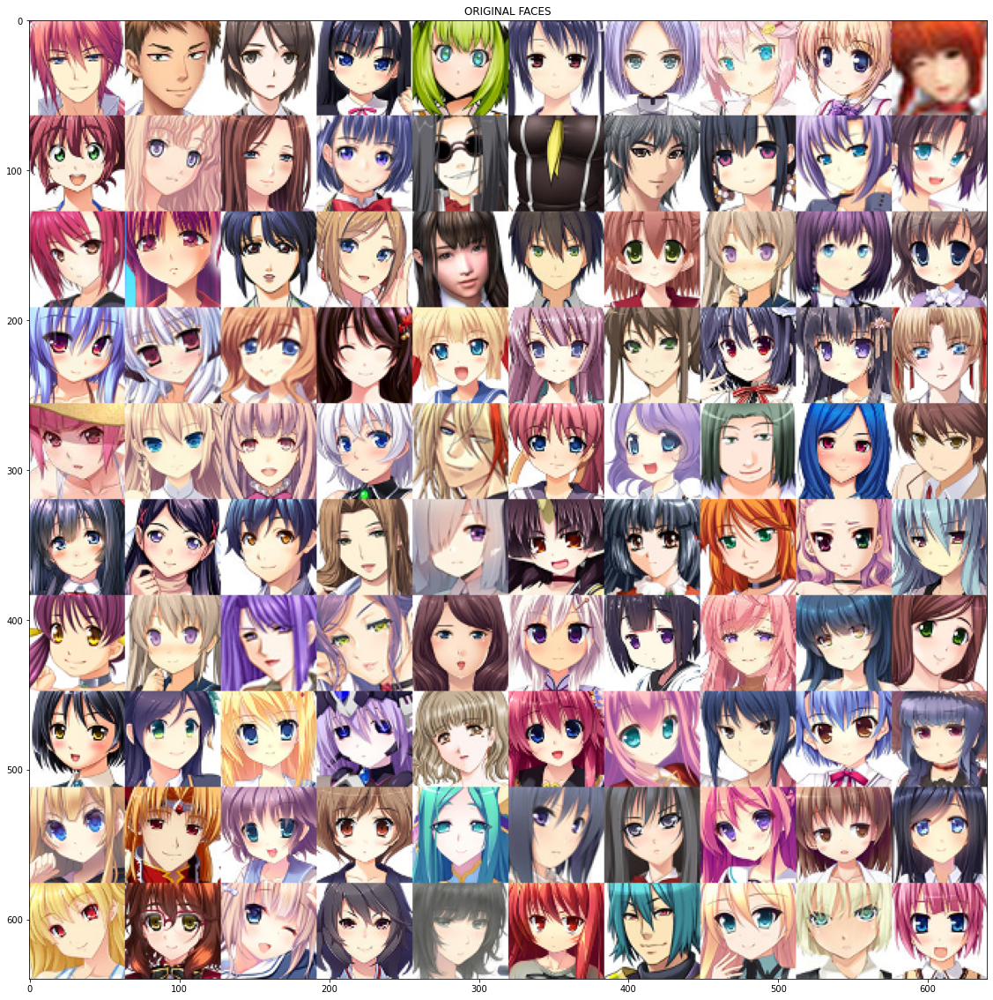

In [ ]:
predictions = x_data_test[:100]
plot_images(10,10,predictions,"ORIGINAL FACES")

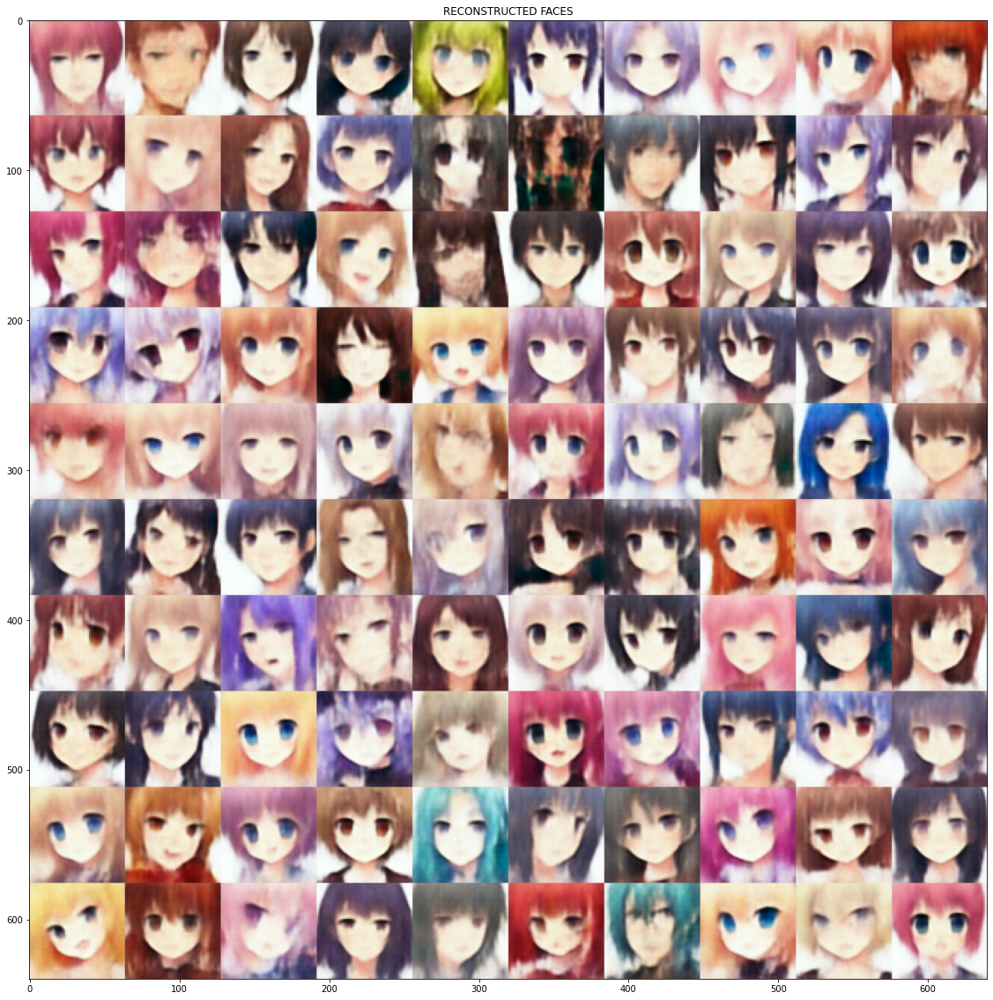

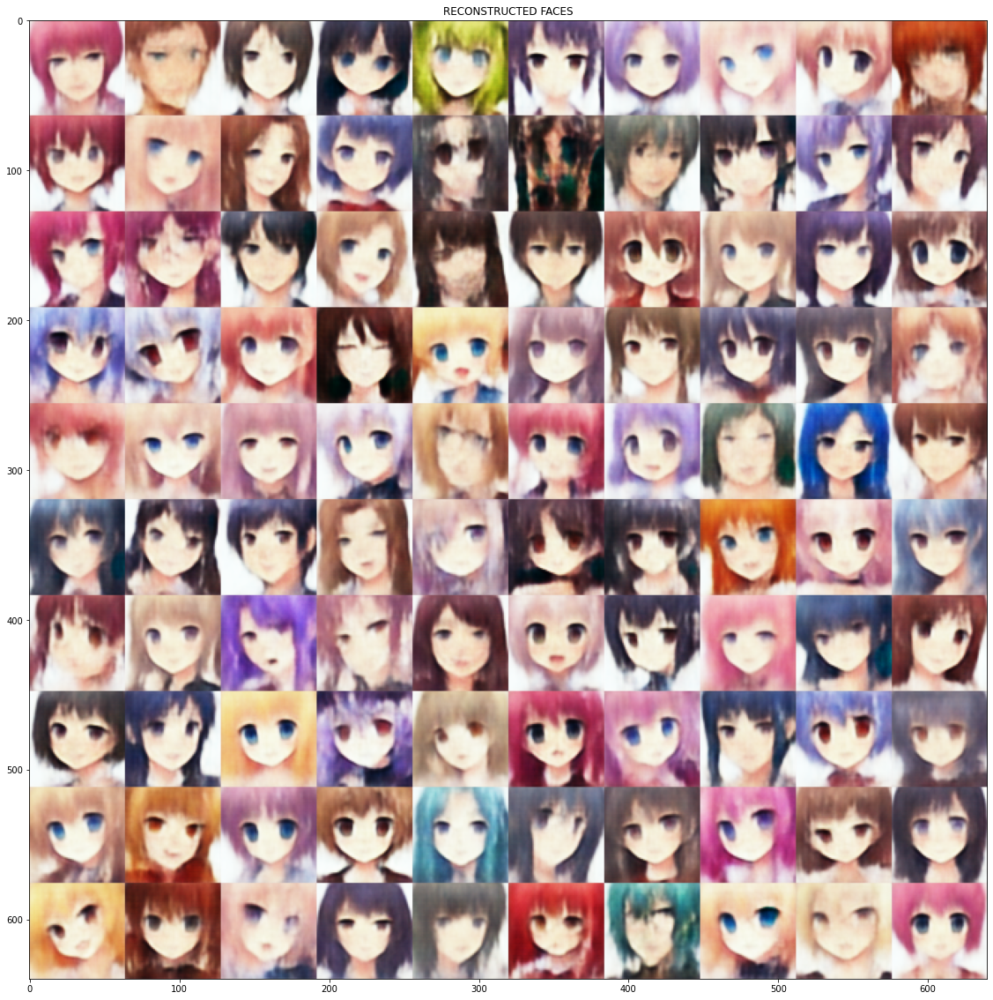

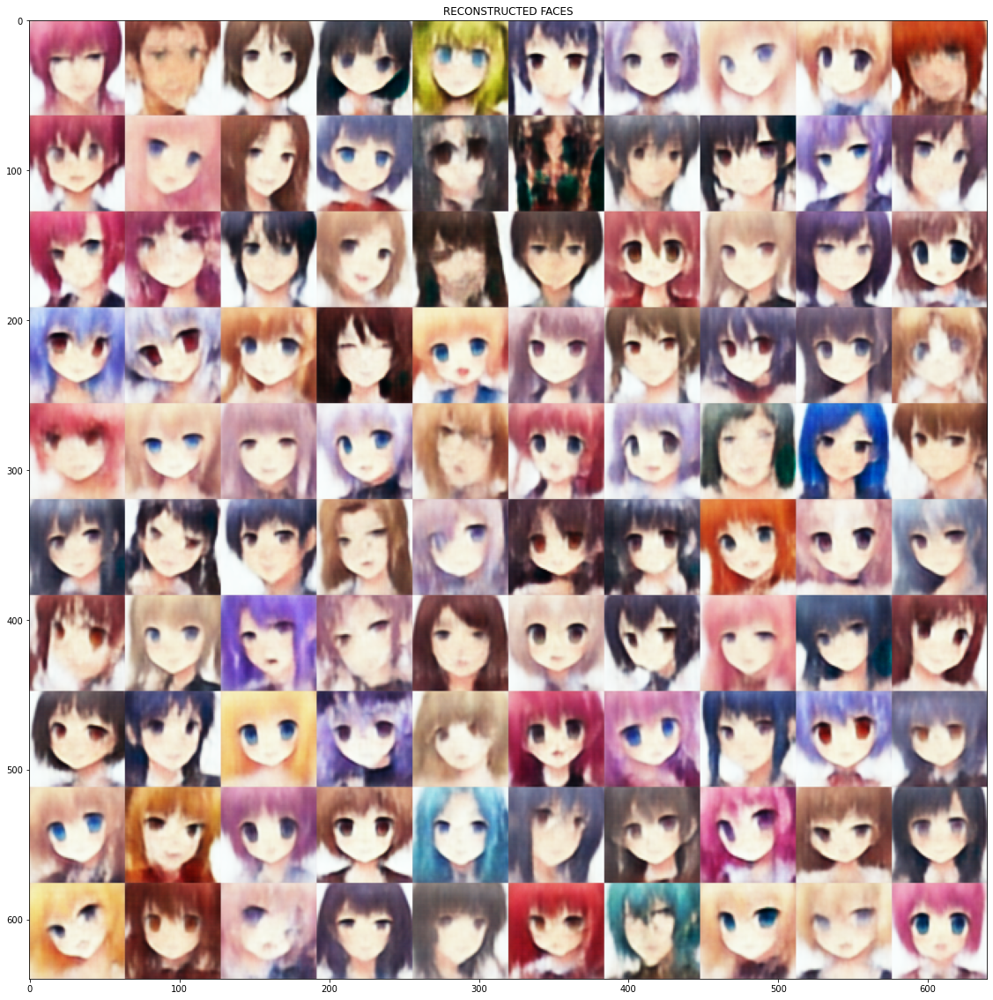

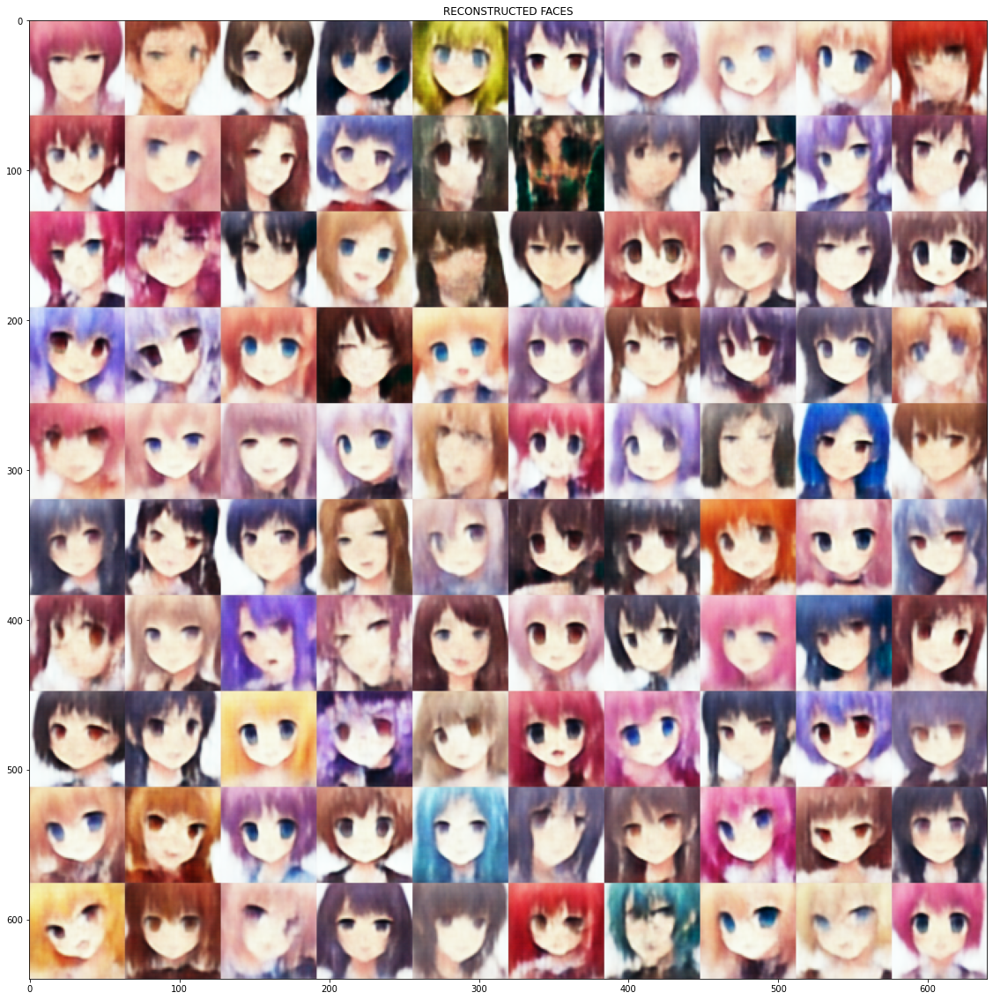

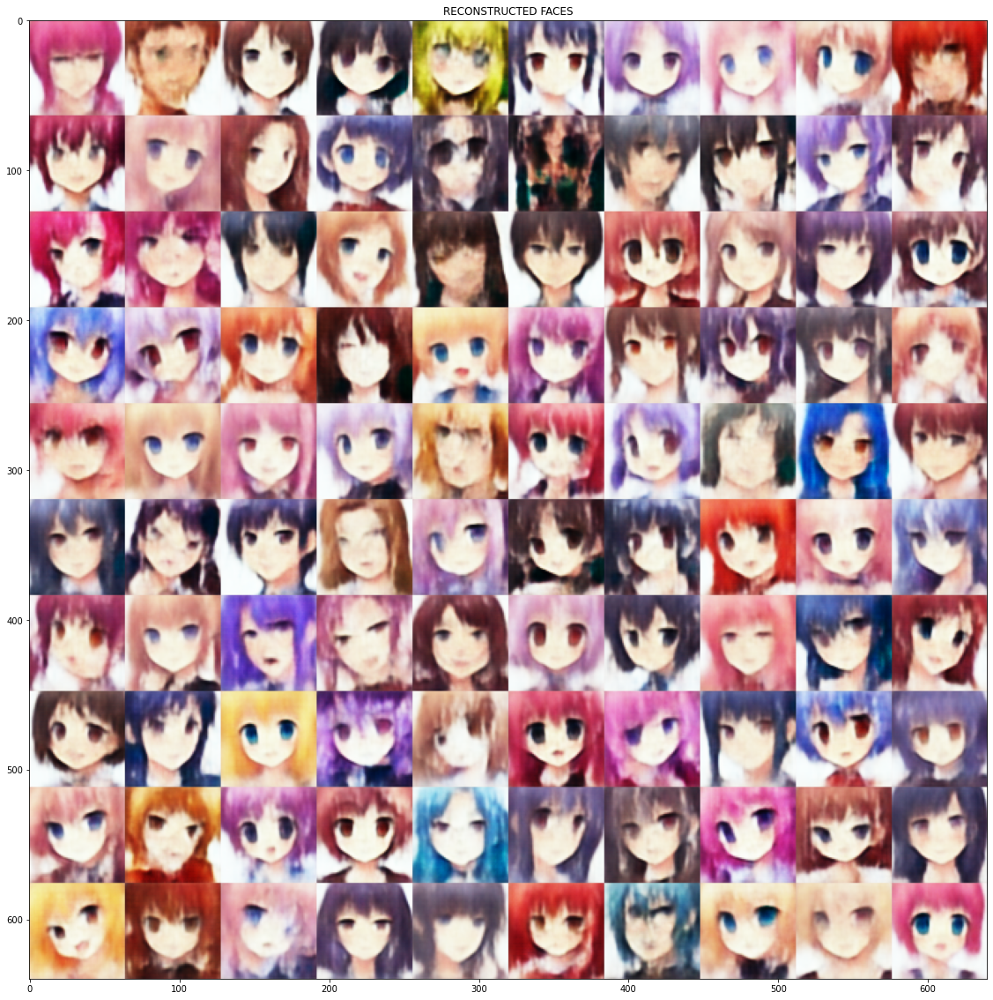

[0.06868599202483892, 0.06960323380306363, 0.06984855256974697, 0.07337828284129501, 0.08488373935222626]


In [ ]:
ruidos = [0.1,0.2,0.3,0.5,0.8]
diff = []
for i in ruidos:
  x_data_noise3 = x_data_test + i * np.random.normal(loc=0.0, scale=1.0, size=x_data_test.shape) 
  predictions  = vae.predict(x_data_noise3[:100])
  plot_images(10,10,predictions, "RECONSTRUCTED FACES")
  suma_img = 0
  for j in range(100):
    suma_img = suma_img + np.sum((x_data_test[j]-predictions[j])**2) / (x_data_test[j].shape[0]*x_data_test[j].shape[1])
  diff.append(suma_img/100)
print(diff)

**DAE aplicado al Dataset**

In [ ]:
#DAE
noise = 0.5
x_data_noise = x_data_train + noise * np.random.normal(loc=0.0, scale=1.0, size=x_data_train.shape) 
x_data_noise = np.clip(x_data_noise, 0., 1.)

In [ ]:
input_img=Input(shape=(64,64,3))
x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPool2D((2, 2), padding='same')(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
encoded_dae = MaxPool2D((2, 2), padding='same')(x)

# at this point the representation is (7, 7, 32)

x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded_dae)
x = UpSampling2D((2, 2))(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded_dae = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

autoencoder = Model(input_img, decoded_dae)
autoencoder.compile(optimizer='adadelta', loss='binary_crossentropy')

In [ ]:
autoencoder.fit(x_data_noise, x_data_train,
                epochs=50,
                batch_size=128,
                shuffle=True,
                validation_data=(x_data_noise, x_data_train))

Train on 17240 samples, validate on 17240 samples
Epoch 1/50
17240/17240 [==============================] - 8s 476us/step - loss: 0.6049 - val_loss: 0.5404
Epoch 2/50
17240/17240 [==============================] - 7s 415us/step - loss: 0.5449 - val_loss: 0.5346
Epoch 3/50
17240/17240 [==============================] - 7s 416us/step - loss: 0.5312 - val_loss: 0.5239
Epoch 4/50
17240/17240 [==============================] - 7s 418us/step - loss: 0.5251 - val_loss: 0.5214
Epoch 5/50
17240/17240 [==============================] - 7s 419us/step - loss: 0.5215 - val_loss: 0.5221
Epoch 6/50
17240/17240 [==============================] - 7s 420us/step - loss: 0.5192 - val_loss: 0.5243
Epoch 7/50
17240/17240 [==============================] - 7s 418us/step - loss: 0.5171 - val_loss: 0.5177
Epoch 8/50
17240/17240 [==============================] - 7s 420us/step - loss: 0.5154 - val_loss: 0.5119
Epoch 9/50
17240/17240 [==============================] - 7s 418us/step - loss: 0.5142 - val_loss: 0.5

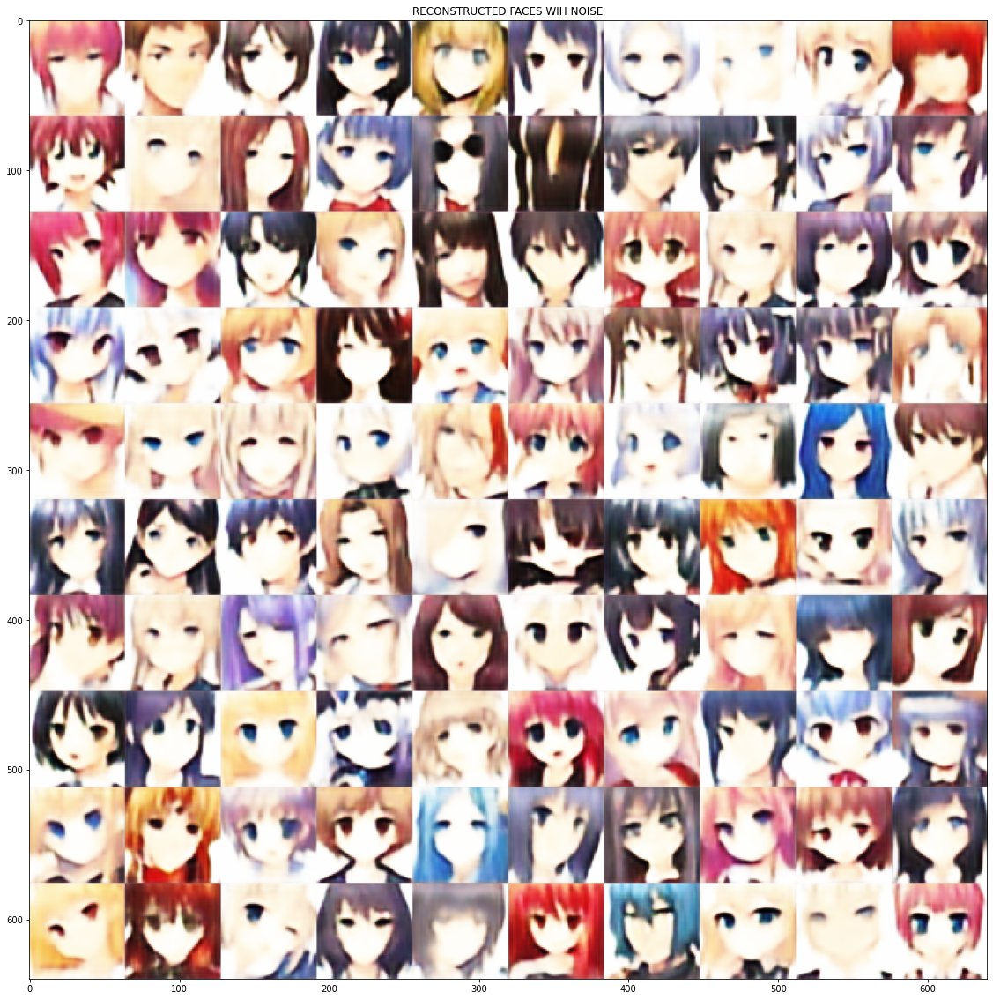

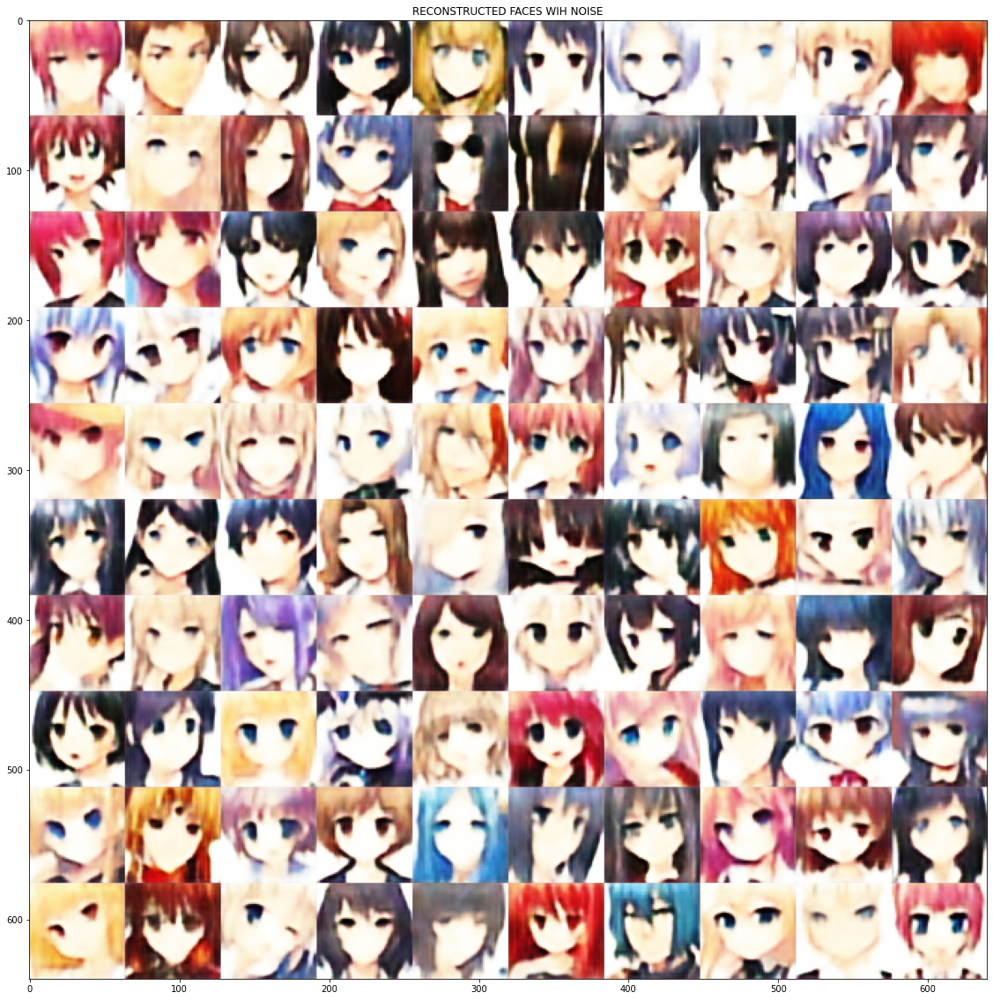

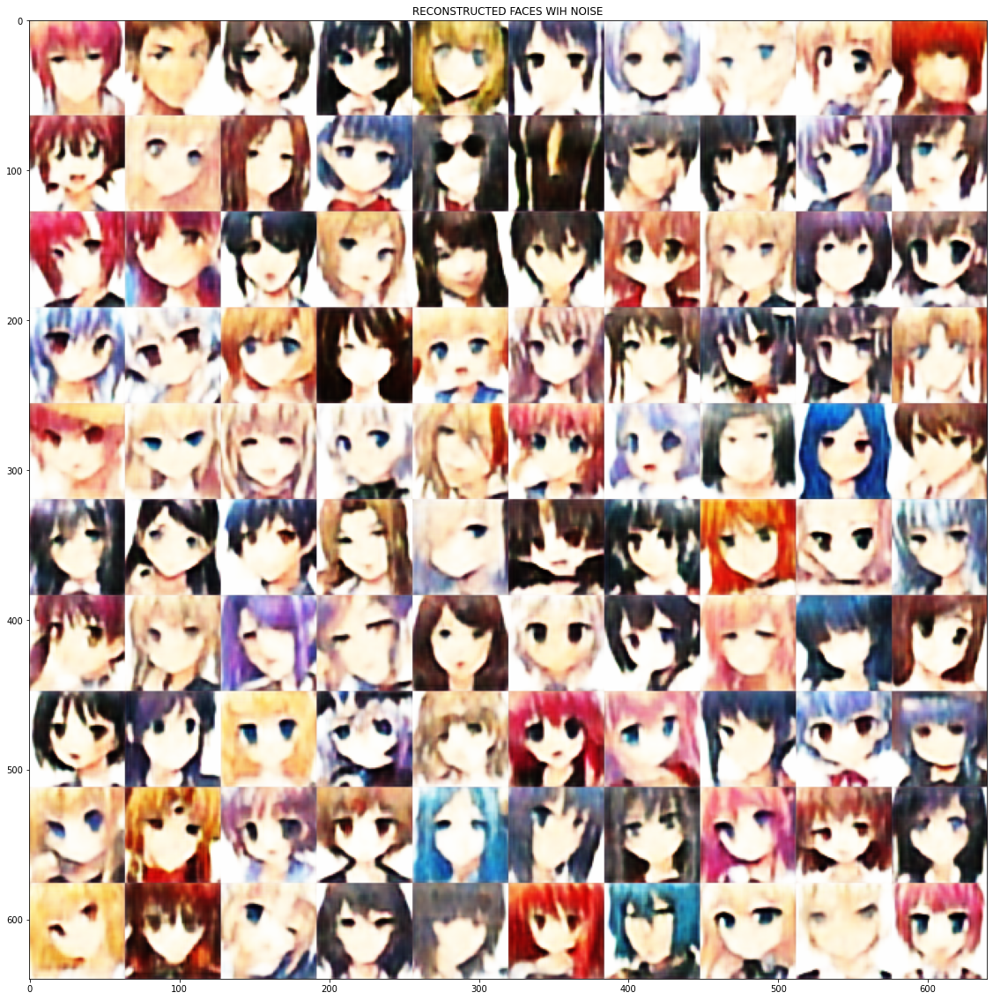

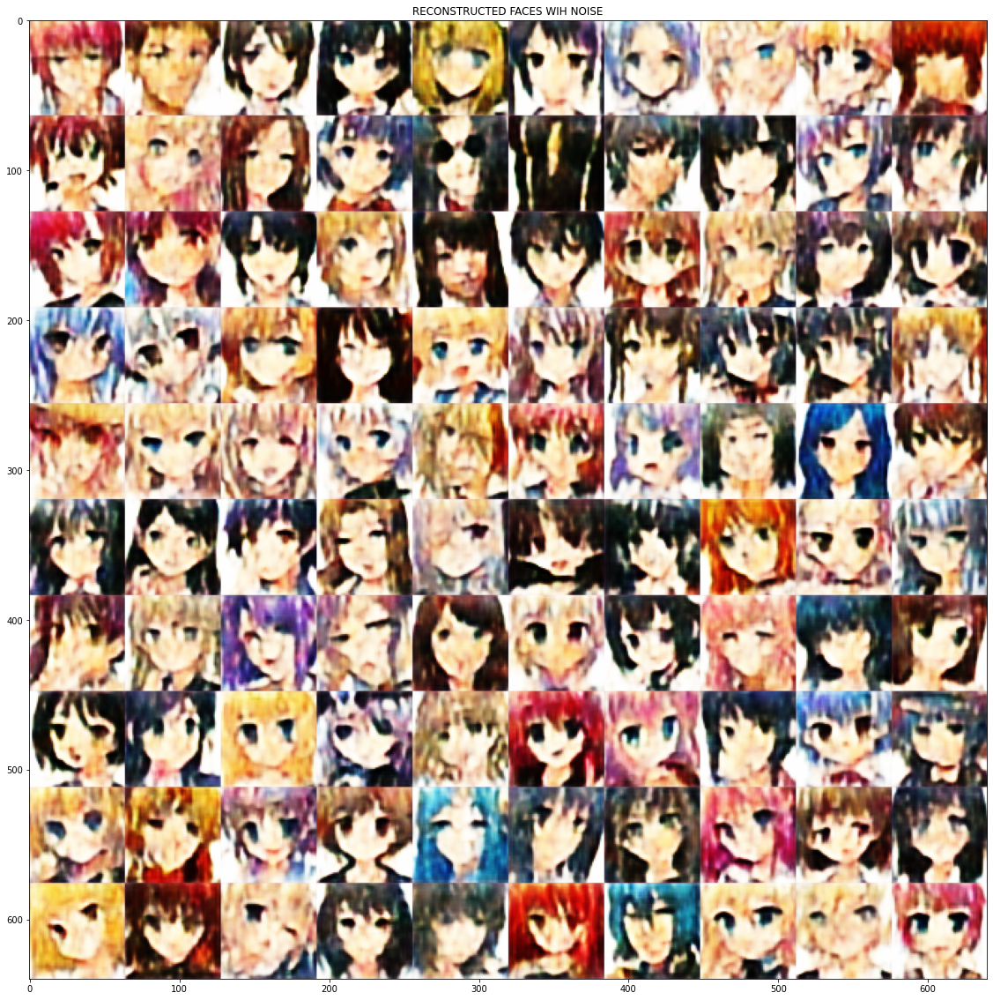

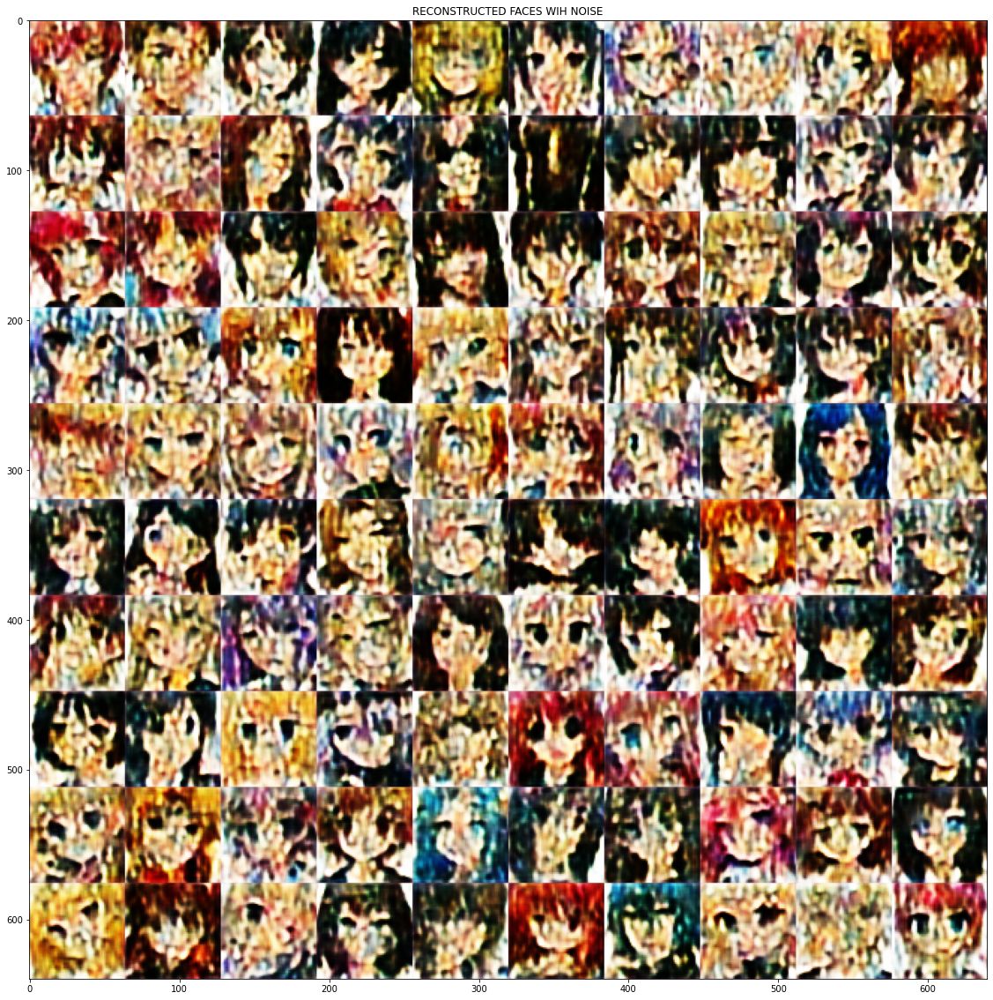

[0.08706052780151367, 0.07122795447707177, 0.06225268229842186, 0.07711351715028286, 0.1849407736212015]


In [ ]:
ruidos = [0.1,0.2,0.3,0.5,0.8]
diff_dae = []
for i in ruidos:
  x_data_noise2 = x_data_test + i * np.random.normal(loc=0.0, scale=1.0, size=x_data_test.shape) 
  noise_images = autoencoder.predict(x_data_noise2[:100])
  plot_images(10,10,noise_images, "RECONSTRUCTED FACES WIH NOISE")
  suma_img_dae = 0
  for j in range(100):
    suma_img_dae = suma_img_dae + np.sum((x_data_test[j]-noise_images[j])**2) / (x_data_test[j].shape[0]*x_data_test[j].shape[1])
  diff_dae.append(suma_img_dae/100)
print(diff_dae)   

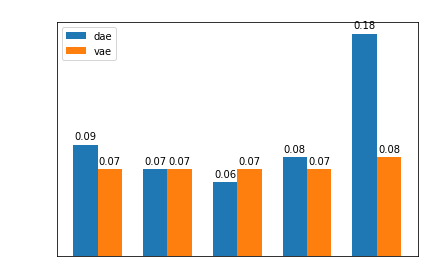

In [ ]:
labels = ['10%', '20%', '30%', '50%', '80%']
diff_dae = np.around(diff_dae, 2)
diff = np.around(diff, 2)

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, diff_dae, width, label='dae')
rects2 = ax.bar(x + width/2, diff, width, label='vae')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('MSE', color="w")
ax.set_title('DAE vs VAE MSE (adding noise)', color="w")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.tick_params(axis='x', colors='w') #white x axis
ax.tick_params(axis='y', colors='w') #white y axis
ax.legend()

def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

fig.tight_layout()
plt.show()

**Análisis de resultados**.

Como se puede apreciar en el grafico anterior, VAE presenta una muy buena robustez aun cuando se varían las tazas de ruidos, ya que se mantiene constante y sin mucha varianza entre un porcentaje de ruido y otro. Por otro lado, DAE presenta una mayor variabilidad y por ende una sensibilidad al ruido, sin embargo, cuando se predicen los datos con un ruido cercano la entrenado (50%) el MSE se reduce bastante, esto puede deberse a que los datos están “overfitiados” por lo que se obtienen mejores resultados, finalmente cuando las tasas de ruidos se aumentan se puede apreciar una clara diferencia en cuanto a la robustez de VAE v/s DAE.